# Aprendizado Supervisionado

Jaime Hikaru Mishima

## Contexto
### Small Business Administration (SBA) Histórico de Empréstimos (7a and 504)
Mais de 1.6M de empréstimos são garantidos pelo SBA (Small Business Administration) como parte dos programas 7(a) e 504. O dataset inclui o nome, endereço e indústria da empresa tomadora do empréstimo, bem como o valor total do empréstimo, o status do termo e detalhes do banco que está emprestando.

- Empréstimos 7(a): no valor máximo de 2M de dólares, com a garantia do SBA de até 75% (1.5M de dólares)
- Empréstimos 504: programa que oferece para pequenos negócios empréstimos de longo prazo, financiamento com taxas fixas usadas para aquisição de ativos, expansão ou modernização. São disponibilizados via CDCs (Certified Development Companies), parceiros da comunidade SBA.


[Localização de base](https://aws.amazon.com/marketplace/pp/prodview-27syih2hg4av2?qid=1587175655831&sr=0-25&ref_=srh_res_product_title#overview)
<br>
[Fonte](https://www.sba.gov/about-sba/open-government/foia#section-header-32)

## Previsão de Default em Empréstimos
A Small Business Administration (SBA) é uma agência norte-americana que apoia as pequenas empresas. A SBA conecta empreendedores com credores e financiamento para ajudá-los a planejar, iniciar e expandir seus negócios. Com uma base histórica de empréstimos feitos desde 2009, a ideia é prever o não pagamento de acordo com variáveis de negócio.

## 0. Importar Bibliotecas

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn import preprocessing
from matplotlib import pyplot as plt
import fklearn, matplotlib
from tqdm import tqdm

# Built-in python libraries
import sys
import os
from urllib.request import urlretrieve

from sklearn.feature_selection import SelectKBest, chi2 
from sklearn.preprocessing import MinMaxScaler

from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.neighbors import KNeighborsClassifier

from sklearn.model_selection import train_test_split
from fklearn.preprocessing.splitting import time_split_dataset
from fklearn.preprocessing.splitting import space_time_split_dataset

from sklearn.model_selection import cross_val_score

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
import itertools
from itertools import groupby
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_auc_score
from sklearn.externals import joblib

# Wanted palette details
# Disclaimer: based on https://stackoverflow.com/questions/52652264/set-custom-seaborn-color-palette-using-hex-codes-and-name-the-colors
enmax_palette = ["#6adbd9", "#434343"]
color_codes_wanted = ['verde_fia', 'cinza_fia']

c = lambda x: enmax_palette[color_codes_wanted.index(x)]

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [2]:
print("Python version:\n{}\n".format(sys.version))
print("matplotlib version: {}".format(matplotlib.__version__))
print("pandas version: {}".format(pd.__version__))
print("numpy version: {}".format(np.__version__))

Python version:
3.7.6 (default, Jan  8 2020, 13:42:34) 
[Clang 4.0.1 (tags/RELEASE_401/final)]

matplotlib version: 3.1.1
pandas version: 0.24.2
numpy version: 1.16.6


In [51]:
#from HelperMethods import HelperClass
# Reference https://github.com/jaimemishima/Data-Science-Projects/blob/master/Credit%20Card%20Fraud%20Detection.ipynb
class HelperClass(object):
        
    # helper method
    @staticmethod
    def stars():
        print ("***********************")
    
    # print metrics as dataframe
    @staticmethod
    def print_dataframe(values):
    
        metrics_print = ['True Positive', 'True Negative', 'False Negative', 'False Positive',
    'Accuracy', 'Precision', 'Recall', 'Specificity', 'F1 Score', 'Roc Auc Score']

        df_metrics = pd.DataFrame(
            {'Metrics': metrics_print,
             'Values': values
            })

        print (df_metrics.to_string(header=False, index=False))
        HelperClass.stars()
        
    def return_dataframe(values, colName):
    
        metrics_print = ['True Positive', 'True Negative', 'False Negative', 'False Positive',
    'Accuracy', 'Precision', 'Recall', 'Specificity', 'F1 Score', 'Roc Auc Score']

        df_metrics = pd.DataFrame(
            {'Metrics': metrics_print,
             colName: values
            })

        return df_metrics
        
    # Disclaimer: metodo obtido em:
    # http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html

    # Metodo para plotar a matrix de confusao
    @staticmethod
    def plot_confusion_matrix(cm, classes,
                              normalize=False,
                              title='Matriz de Confusão',
                              cmap=plt.cm.Blues):
        """
        This function prints and plots the confusion matrix.
        Normalization can be applied by setting `normalize=True`.
        """
        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix:")
        else:
            print('Confusion matrix, without normalization:')

        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title,fontsize=15)
        plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        fmt = '.2f' if normalize else 'd'
        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

        plt.tight_layout()
        plt.ylabel('True label')
        plt.xlabel('Predicted label')
        
        # adjust plot
        
        bottom, top = plt.gca().get_ylim()
        plt.gca().set_ylim(bottom + 0.5, top - 0.5)
        plt.show()


    # ROC curve
    @staticmethod
    def plot_roc_curve(y_true, y_scores):
        
        fpr, tpr, thresholds = roc_curve(y_true, y_scores)

        HelperClass.stars()
        print ("Curva Roc:")
        HelperClass.stars()
        figsize=(15, 5)
        auc = '{:.3f}'.format(roc_auc_score(y_true, y_scores))
        print(auc)
        plt.plot([0,1],[0,1], 'k--', linewidth = 2)
        plt.plot(fpr, tpr, label = 'AUC='+str(auc), linewidth = 2)
        plt.title('Curva ROC', fontsize=15)
        plt.xlabel('Taxa de Falso Positivo')
        plt.ylabel('Taxa de Verdadeiro Positivo')
        plt.legend(loc='lower right')
        plt.show()


    # Precision Recall Curve
    @staticmethod
    def plot_precision_recall_curve(y_true, y_scores):

        HelperClass.stars()
        print ("Curva Precision Recall:")
        HelperClass.stars()

        precision, recall, thresholds = precision_recall_curve(y_true, y_scores)

        plt.step(recall, precision, color = 'b', alpha = 0.2, where = 'post')

        plt.plot(recall, precision, linewidth=2)
        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Curva Precision Recall')
        plt.show()

    # Show classification report
    @staticmethod
    def classification_dataframe(y_true, y_pred, y_scores, classes, colName = 'Values'):
        cm = confusion_matrix(y_true, y_pred)

        true_positive = cm[1,1]
        true_negative = cm[0,0]
        false_negative = cm[1,0]
        false_positive = cm[0,1]

        accuracy = ((true_positive + true_negative)/(true_positive + true_negative + false_negative + false_positive))
        precision = (true_positive/(true_positive + false_positive))
        recall = (true_positive/(true_positive + false_negative))  
        sensitivity = (true_positive/(true_positive + false_negative))  
        specificity = (true_negative/(true_negative + false_positive))  
        f1_score = ((2 * precision * recall)/(precision + recall))
        roc_auc = roc_auc_score(y_true, y_scores)
        
        values = []
        values.append(true_positive)
        values.append(true_negative)
        values.append(false_negative)
        values.append(false_positive)
        values.append('{:.4f}'.format(accuracy))
        values.append('{:.4f}'.format(precision))
        values.append('{:.4f}'.format(recall))
        values.append('{:.4f}'.format(specificity))
        values.append('{:.4f}'.format(f1_score))
        values.append('{:.4f}'.format(roc_auc))

        return HelperClass.return_dataframe(values, colName)

    # Show classification report
    @staticmethod
    def show_full_classification_report(y_true, y_pred, y_scores, classes):

        HelperClass.stars()
        print ("Metrics Report:")
        HelperClass.stars()

        cm = confusion_matrix(y_true, y_pred)

        true_positive = cm[1,1]
        true_negative = cm[0,0]
        false_negative = cm[1,0]
        false_positive = cm[0,1]

        accuracy = ((true_positive + true_negative)/(true_positive + true_negative + false_negative + false_positive))
        precision = (true_positive/(true_positive + false_positive))
        recall = (true_positive/(true_positive + false_negative))  
        sensitivity = (true_positive/(true_positive + false_negative))  
        specificity = (true_negative/(true_negative + false_positive))  
        f1_score = ((2 * precision * recall)/(precision + recall))
        
        roc_auc = roc_auc_score(y_true, y_scores)

        print ("Classification Report:")
        HelperClass.stars()

        values = []

        values.append(true_positive)
        values.append(true_negative)
        values.append(false_negative)
        values.append(false_positive)
        values.append('{:.4f}'.format(accuracy))
        values.append('{:.4f}'.format(precision))
        values.append('{:.4f}'.format(recall))
        values.append('{:.4f}'.format(specificity))
        values.append('{:.4f}'.format(f1_score))
        values.append('{:.4f}'.format(roc_auc))

        HelperClass.print_dataframe(values)

        HelperClass.plot_confusion_matrix(cm, classes)

        HelperClass.plot_roc_curve(y_true, y_scores)

        HelperClass.plot_precision_recall_curve(y_true, y_scores)


    def plot_corr_matrix(correlations,attr, figsize=[15,10]):
      """Retorna o heatmap de uma lista de listas com as correlacoes de variaveis
      Args:
        correlations - lista de lista com as correlacoes
        attr - lista com os nomes das variaveis
        fig_no - If not provided, a new figure will be created, and the figure number will be incremented (para o plt.figure)
        figsize 0- tamanho do heatmap
      Returns:
        Heatmap com a matriz de correlacao
        """
      fig=plt.figure(figsize=figsize)
      ax=fig.add_subplot(111)
      ax.set_title("Correlacao Variaveis")
      ax = sns.heatmap(correlations, cmap="YlGnBu")
      indice = list(range(1, len(attr)+1))
      indice = [str(s) + ' - ' for s in indice]
      res = [i + j for i, j in zip(indice, attr)] 
      #ax.set_xticks(range(len(filter_colunas_order)))
      ax.set_yticklabels(res)
      plt.yticks(rotation=0) 
      plt.show()
     
       
def shareByColumn(df,col, columnName='Loans', sort_by_index=False):
    """Retorna o dataframe com o count da coluna col e o share em percentual
      Args:
        df - dataframe
        col - nome da coluna a ser agrupada
        columnName - nome base da coluna agrupada
        sort_by_index - if sort is by index
      Returns:
        Dataframe com o count da coluna col e o share (em percentual) da mesma
        """
    grouped = df[col].groupby(df[col]).count().to_frame()
    if(sort_by_index):
        grouped = grouped.rename(columns={col: columnName}).sort_index(ascending=True)
    else:
        grouped = grouped.rename(columns={col: columnName}).sort_values(by=columnName, ascending=False)
    grouped['Share '+columnName+' (%)'] = grouped[columnName].div(grouped[columnName].sum(), axis=0).multiply(100)
    return grouped


# http://www.jesshamrick.com/2016/04/13/reproducible-plots/
# based on: https://stackoverflow.com/questions/45946970/displaying-of-values-on-barchart
sns.set_style("white")
sns.despine(left=True)
enmax_palette = ["#6adbd9", "#434343"]
color_codes_wanted = ['verde_fia', 'cinza_fia']
def plotBar(x, y, data, title, xlabel='', ylabel='', figsize=(15, 5), 
            color=c("verde_fia"), rotation_x=0, annotation=True, y_is_k=True, label=''):
    """Retorna o bar plot
      Args:
        x - eixo x do plot
        y - eixo y do plot
        data - dataframe
        title - nome do titulo do bar plot
        xlabel - nome da label do eixo x
        ylabel - nome da label do eixo y
        figsize - tamanho do plot
        color - cor das barras
        rotation_x - angulo de rotacao das labels do eixo x
        annotation - true para adicionar anotacoes
        y_is_k - eixo y exibido em k (ex: 1000 fica 1k)
      Returns:
        Objeto seaborn do bar plot
        """
    plt.figure(figsize=figsize)
    ax = sns.barplot(x=x, y=y,data=data,color=color, label=label)
    ax.axes.set_title(title,fontsize=15)
    ax.set(xlabel=xlabel, ylabel=ylabel)
    ax.set_ylabel(ylabel=ylabel,fontsize=12, color='#77CDCB')
    if y_is_k:
        ylabels = ['{:,.0f}'.format(y) + 'k' for y in ax.get_yticks()/1000]
        ax.set_yticklabels(ylabels)
    ax.set_xticklabels(x, rotation=rotation_x, fontsize=9, horizontalalignment='right')
    if(annotation):    
        for p in ax.patches:
        #     ax.annotate('{:,.2f}'.format(p.get_height()/1000), 
            ax.annotate("%.0f" % p.get_height(),
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                        ha='center', 
                        va='center', 
                        fontsize=11,
                        color='gray',
                        xytext=(0, 20),
                        textcoords='offset points')
    sns.set_style("white")
    sns.despine(left=True)
    return ax

import plotly.express as px
def plot_boxplot(df, x, y, title, x_title, y_title, width=800, height=400):
    fig = px.box(df, y=y, x=x,
                 template='simple_white',width=width, height=height)
    fig.update_layout(
        title={
            'text': title,
            'y':0.92,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis_title=x_title,
        yaxis_title=y_title,
        font_color="black",
        title_font_color="black",
        font=dict(
            family="Open Sans",
            size=12)
    )
    fig.update_traces(marker_color='LightSeaGreen')
    return fig


### Feature Importances
# Reference: https://github.com/erykml/medium_articles/blob/master/Machine%20Learning/feature_importance.ipynb
# function for creating a feature importance dataframe
def imp_df(column_names, importances):
    df = pd.DataFrame({'feature': column_names,
                       'feature_importance': importances}) \
           .sort_values('feature_importance', ascending = False) \
           .reset_index(drop = True)
    return df

# plotting a feature importance dataframe (horizontal barchart)
def var_imp_plot(imp_df, xlabel='Importância', ylabel='Variável', 
                 title='Importância das Variáveis', figsize=(10, 5), color=c("verde_fia"),
                 annotation=True):
    plt.figure(figsize=figsize)
    ax = sns.barplot(x = 'feature_importance', y = 'feature', data = imp_df, orient = 'h', color=color)
    ax.set(xlabel=xlabel, ylabel=ylabel)
    ax.axes.set_title(title,fontsize=15)
    if(annotation):    
        for p in ax.patches:
            ax.annotate("%.2f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center")

    sns.set_style("white")
    sns.despine(left=True)
    return ax


def modelMetricsByThreshold(x_test, y_test, y_scores, threshold):
    """Retorna metricas modelo para um determinado threshold
    Args:
        x_test: features
        y_test: variavel resposta
        y_scores: score da variavel resposta retornado pelo modelo
        threshold: limiar a ser aplicado em y_scores para definir 1 ou 0 na Target
    Returns:
        lista com métricas de avaliacao do modelo:
            TP: true positives
            TN: true negatives
            FN: false negatives
            FP: false positives
            accuracy, precision, recall, f1_score
            gross_loss: valor em USD perdido por empréstimos dados devido a falso negativo
            opportunity_loss: valor em USD deixados de emprestar devido a falso positivo
            sba_gross_loss: gross_loss do SBA
            sba_opportunity_loss: opportunity_loss do SBA
        """
    df_treated = x_test.join(y_teste_selected)
    df_treated['scores'] = y_scores
    df_treated['Predicted'] = np.where(df_treated['scores'] >= threshold, 1, 0)
    df_treated['TP'] = np.where((df_treated['Target'] == 1) & (df_treated['Predicted'] == 1), 1, 0)
    df_treated['TN'] = np.where((df_treated['Target'] == 0) & (df_treated['Predicted'] == 0), 1, 0)
    df_treated['FP'] = np.where((df_treated['Target'] == 0) & (df_treated['Predicted'] == 1), 1, 0)
    df_treated['FN'] = np.where((df_treated['Target'] == 1) & (df_treated['Predicted'] == 0), 1, 0)

    df_treated['gross_loss'] = df_treated['FN'] * df_treated['GrossApproval']
    df_treated['opportunity_loss'] = df_treated['FP'] * df_treated['GrossApproval']
    df_treated['sba_gross_loss'] = df_treated['FN'] * df_treated['SBAGuaranteedApproval']
    df_treated['sba_opportunity_loss'] = df_treated['FP'] * df_treated['SBAGuaranteedApproval']

    df = df_treated[['GrossApproval', 'SBAGuaranteedApproval', 'Target', 
                         'scores', 'Predicted','TP', 'TN', 'FP', 'FN',
                         'gross_loss', 'opportunity_loss', 'sba_gross_loss',
                         'sba_opportunity_loss'
                        ]]

    metrics = df.sum().to_frame().rename(columns={0:'total'})#.reset_index().rename(columns={'index':'variable'})

    TP = metrics.loc['TP']['total']
    TN = metrics.loc['TN']['total']
    FN = metrics.loc['FN']['total']
    FP = metrics.loc['FP']['total']

    accuracy = ((TP + TN)/(TP + TN + FN + FP))
    precision = (TP/(TP + FP))
    recall = (TP/(TP + FN))  
    sensitivity = (TP/(TP + FN))  
    specificity = (TN/(TN + FP))  
    f1_score = ((2 * precision * recall)/(precision + recall))

    aux = metrics.T.reset_index().rename(columns={'index':'threshold'})
    aux['accuracy'] = accuracy
    aux['precision'] = precision
    aux['recall'] = recall
    aux['sensitivity'] = sensitivity
    aux['specificity'] = specificity
    aux['f1_score'] = f1_score
    aux['threshold'] = threshold
    
    return aux

def metricsByThresholdRange(x_test, y_test, y_scores, lower_threshold = 0.0, higher_threshold = 1.0, step = 0.1):
    """Retorna dataframe com metricas de avaliacao da funcao modelMetricsByThreshold entre dois thresholds.
    Args:
        x_test: features
        y_test: variavel resposta
        y_scores: score da variavel resposta retornado pelo modelo
        lower_ threshold: limiar inferior
        higher_ threshold: limiar superior
    """
    column_names = ['threshold', 'GrossApproval', 'SBAGuaranteedApproval', 'Target',
       'scores', 'Predicted', 'TP', 'TN', 'FP', 'FN', 'gross_loss',
       'opportunity_loss', 'sba_gross_loss', 'sba_opportunity_loss',
       'accuracy', 'precision', 'recall', 'sensitivity', 'specificity',
       'f1_score']
    df_final = pd.DataFrame(columns = column_names)
    threshold = lower_threshold
    while(threshold < higher_threshold):
        aux = modelMetricsByThreshold(x_test, y_test, y_scores, threshold)
        df_final = pd.concat([df_final,aux],ignore_index=True)
        threshold += step
    return df_final

<Figure size 432x288 with 0 Axes>

In [4]:
pd.set_option('display.max_columns', None) # para mostrar todas as colunas

## 1. Tratamento da Base

### Leitura arquivo .xlsx e conversão para csv

In [12]:
# raw = pd.read_excel("FOIA - 7(a)(FY2010-Present).xlsx", sheet_name="7A_FY2010_Present")
# raw.to_csv("foia_7a.csv",index = False, header=True)

In [5]:
path = '/Users/jaime.mishima/Desktop/MBA/TCC/SBA Loans/Bases'
df = pd.read_csv(path+"/foia_7a.csv")

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3051: DtypeWarning:

Columns (11,31,32) have mixed types. Specify dtype option on import or set low_memory=False.



In [6]:
df.shape

(557542, 36)

### Tratamento de datas e categóricas; criação da Target (1 para não pagamento)

In [102]:
# Date treatment
df['AsOfDate'] = df['AsOfDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y%m%d'))
df['ApprovalDate'] = df['ApprovalDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y-%m-%d'))
df['FirstDisbursementDate'] = df['FirstDisbursementDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y-%m-%d'))
df['PaidInFullDate'] = df['PaidInFullDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y-%m-%d'))
df['Target'] = np.where(df['PaidInFullDate'].isnull(), 1, 0)

In [103]:
# converting categorical columns
df['NaicsCode'] = df['NaicsCode'].astype(str)
df['CongressionalDistrict'] = df['CongressionalDistrict'].astype(str, skipna = True)
df['BorrZip'] = df['BorrZip'].astype(str).replace('nan', np.nan)
df['BankZip'] = df['BankZip'].astype(str).replace('nan', np.nan)
df['FranchiseCode'] = df['FranchiseCode'].astype(str, skipna = True)
df['FranchiseName'] = df['FranchiseName'].astype(str, skipna = True)

#df['Id'] = range(1, 1+len(df))

In [104]:
df['LoanStatus'].value_counts()

EXEMPT    262118
PIF       198609
CANCLD     62404
CHGOFF     18380
COMMIT     16031
Name: LoanStatus, dtype: int64

In [105]:
statusShare = shareByColumn(df,'LoanStatus', columnName='Loans')
statusShare

,Loans,Share Loans (%)
LoanStatus,,
EXEMPT,262118,47.01
PIF,198609,35.62
CANCLD,62404,11.19
CHGOFF,18380,3.30
COMMIT,16031,2.88


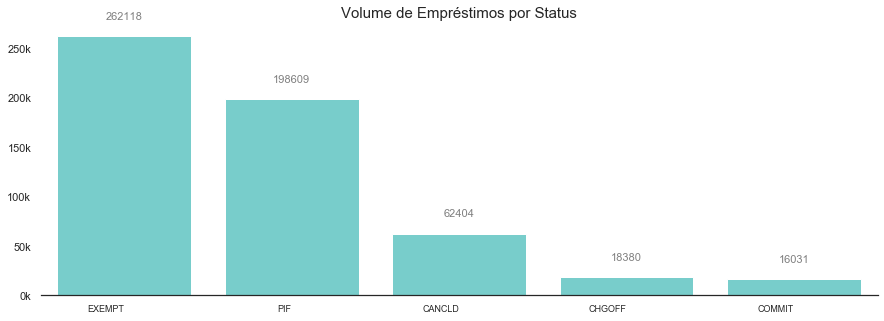

In [106]:
ax = plotBar(x=statusShare.index, y='Loans', data=statusShare, 
             title='Volume de Empréstimos por Status', 
             xlabel='', ylabel='', rotation_x=0, annotation=True)

### Mantém somente empréstimos pagos totalmente e os cobrados

In [107]:
# vamos manter somente os emprestimos que foram totalmente pagos (PIF = Paid in Full) e cobrados (CHGOFF = Charged Off)
# COMMIT = não desembolsado, CANCLD = cancelado, EXEMPT = foram desembolsados mas não foram cancelados, cobrados ou pagos.
df = df[df['LoanStatus'].isin(['PIF', 'CHGOFF'])]

In [108]:
df.dtypes

AsOfDate                 datetime64[ns]
Program                          object
BorrName                         object
BorrStreet                       object
BorrCity                         object
BorrState                        object
BorrZip                          object
BankName                         object
BankStreet                       object
BankCity                         object
BankState                        object
BankZip                          object
GrossApproval                     int64
SBAGuaranteedApproval             int64
ApprovalDate             datetime64[ns]
ApprovalFiscalYear                int64
FirstDisbursementDate    datetime64[ns]
DeliveryMethod                   object
subpgmdesc                       object
InitialInterestRate             float64
TermInMonths                      int64
NaicsCode                        object
NaicsDescription                 object
FranchiseCode                    object
FranchiseName                    object


### Checkpoint 1: salva base formato parquet para manter formatação

In [13]:
# checkpoint 1: bases com tratamento de datas e target criada
# df.to_parquet(path+'/checkpoint1_200802.parquet.gzip', compression='gzip')

ArrowTypeError: ('an integer is required (got type str)', 'Conversion failed for column BankZip with type object')

In [24]:
path = '/Users/jaime.mishima/Desktop/MBA/TCC/SBA Loans/Bases'
# df = pd.read_parquet(path+'/checkpoint1_200705.parquet.gzip')
df = pd.read_parquet(path+'/checkpoint1_200802.parquet.gzip')

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 216989 entries, 0 to 545588
Data columns (total 37 columns):
AsOfDate                 216989 non-null datetime64[ns]
Program                  216989 non-null object
BorrName                 216979 non-null object
BorrStreet               216989 non-null object
BorrCity                 216989 non-null object
BorrState                216989 non-null object
BorrZip                  216989 non-null object
BankName                 216989 non-null object
BankStreet               216988 non-null object
BankCity                 216988 non-null object
BankState                216988 non-null object
BankZip                  216988 non-null object
GrossApproval            216989 non-null int64
SBAGuaranteedApproval    216989 non-null int64
ApprovalDate             216989 non-null datetime64[ns]
ApprovalFiscalYear       216989 non-null int64
FirstDisbursementDate    216121 non-null datetime64[ns]
DeliveryMethod           216989 non-null object
subp

In [6]:
print("Base começa  em: "+ str(df['ApprovalDate'].min()))
print("Base termina em: "+ str(df['ApprovalDate'].max()))

Base começa  em: 2009-10-01 00:00:00
Base termina em: 2019-09-30 00:00:00


### Criando variáveis

- **sameStateLoan**: Indica se um mutuário e o banco são do mesmo estado.<br>
Vale entender como funciona a dinâmica de localização dos empréstimos. Quem empresta tem que ser do mesmo estado/cidade de quem recebe o empréstimo?

In [7]:
total_emprestimo = df.count()[0]
emprestimos_mesmo_estado = df[df['BorrState'] == df['BankState']].count()[0]
emprestimos_mesmo_estado_share = emprestimos_mesmo_estado/total_emprestimo
print("{0:.2%}".format(emprestimos_mesmo_estado_share)+ " dos empréstimos foram de bancos e mutuários do mesmo estado.")

df['sameStateLoan'] = np.where(df['BorrState'] == df['BankState'], 1, 0)

45.41% dos empréstimos foram de bancos e mutuários do mesmo estado.


- **sameCityLoan**: Indica se um mutuário e o banco são da mesma cidade.<br>
As colunas de cidade para o mutuário (BorrCity) e do banco (BankCity) seguem o mesmo padrão de nomenclatura? Parece que BorrCity tem maiusculas e minúsculas. Vamos deixar tudo minúsculo para ambas variáveis.

In [8]:
df['BorrCity'] = df['BorrCity'].str.lower()
df['BankCity'] = df['BankCity'].str.lower()

total_emprestimo = df.count()[0]
emprestimos_mesma_cidade = df[df['BorrCity'] == df['BankCity']].count()[0]
emprestimos_mesma_cidade_share = emprestimos_mesma_cidade/total_emprestimo
print("{0:.2%}".format(emprestimos_mesma_cidade_share)+ " dos empréstimos foram de bancos e mutuários da mesma cidade.")

df['sameCityLoan'] = np.where(df['BorrCity'] == df['BankCity'], 1, 0)

7.40% dos empréstimos foram de bancos e mutuários da mesma cidade.


- **shareSBAGuaranteedTotalApproval**: porcentagem do valor emprestado que é garantido pela SBA.<br>
O SBA atua como um intermediário garantindo o pagamento de uma parcela do empréstimo caso o mutuário não efetue o pagamento.

In [9]:
df['shareSBAGuaranteedTotalApproval'] = df['SBAGuaranteedApproval']/df['GrossApproval']

- **daysFromApprovalToFirstDisbursement**: tempo em dias da aprovação do empréstimo até o primeiro desembolso<br>
Qual é a relação entre a `FirstDisbursementDate` e `ApprovalDate`?

In [10]:
# converte timedelta para int
df['daysFromApprovalToFirstDisbursement'] = df['FirstDisbursementDate'] - df['ApprovalDate']
df['daysFromApprovalToFirstDisbursement'] = df['daysFromApprovalToFirstDisbursement']/np.timedelta64(1, 'D')

- **Franchise**:
Um empréstimo foi para uma franquia quando o campo `FranchiseCode` está preenchido. Criamos um campo `Franchise` que é `1` quando foi uma franquia e `0` quando não foi.

In [11]:
#categorical_columns = dados.select_dtypes(include=['object']).columns.tolist()
#for i in categorical_columns:
for i in df.columns:
    df[i] = df[i].replace('nan', np.nan)
df['Franchise'] = np.where(df['FranchiseCode'].isna(), 0, 1)

- **NAICS Code**:<br>
O [NAICS](https://www.census.gov/smallbusiness/html/naics.html) - North American Industry Classification System, Sistema de Classificação da Indústria Norte-Americana na sigla em inglês, é usado pelos Estados Unidos, Canadá e México para classificar negócios pela indústria. Cada negócio é classificado com base num código NAICS baseado em 6 dígitos que descrevem a maioria das atividades dos negócios.<br><br>
Os [6 dígitos](http://www.library.arizona.edu/applications/quickHelp/tutorial/naics/single-page) representam 5 níveis de detalhamento:<br>
- Primeiros dois dígitos = setor da indústria<br>
- 3º dígito = subsetor da indústria<br>
- 4º dígito = grupo da indústria<br>
- 5º dígito = indústria<br>
- 6º dígito = indústria nacional<br><br>

Um exemplo para o código e seu siginificado é [(link referência)](http://www.library.arizona.edu/applications/quickHelp/tutorial/naics/single-page):<br>
- 72: Accommodation and Food Services (setor)
- 722: Food Services & Drinking Places (subsetor)
- 7225: Restaurants and Other Eating Places (grupo)
- 72251: Restaurants and Other Eating Places (indústria)
- 722514: Cafeterias, Grill Buffets, and Buffets (indústria nacional)




In [12]:
naics = df[['NaicsCode','NaicsDescription']]
naics[naics['NaicsCode'] == '722514.0'].head(1)

,NaicsCode,NaicsDescription
146509,722514.0,"Cafeterias, Grill Buffets, and Buffets"


Podemos ver que a cardinalidade do código NAICs é alta (1202 tipos). Com base nisso, vamos criar uma nova variável baseada no nível `setor` do código.

In [13]:
len(df['NaicsCode'].unique())

1202

De acordo com o [manual](https://www.census.gov/eos/www/naics/2017NAICS/2017_NAICS_Manual.pdf) oficial do NAICS, obtido do ["US Census Bureau"](https://www.census.gov/eos/www/naics/) de 2017, temos que o NAICS classifica todas as atividades econômicas em 20 setores. São eles:<br>

- 11 Agriculture, Forestry, Fishing and Hunting<br>
- 21 Mining, Quarrying, and Oil and Gas Extraction<br>
- 22 Utilities<br>
- 23 Construction<br>
- 31-33 Manufacturing<br>
- 42 Wholesale Trade<br>
- 44-45 Retail Trade<br>
- 48-49 Transportation and Warehousing<br>
- 51 Information<br>
- 52 Finance and Insurance<br>
- 53 Real Estate and Rental and Leasing<br>
- 54 Professional, Scientific, and Technical Services<br>
- 55 Management of Companies and Enterprises<br>
- 56 Administrative and Support and Waste Management and Remediation Services<br>
- 61 Educational Services<br>
- 62 Health Care and Social Assistance<br>
- 71 Arts, Entertainment, and Recreation<br>
- 72 Accommodation and Food Services<br>
- 81 Other Services (except Public Administration)<br>
- 92 Public Administration

In [14]:
naicsCode = {'NaicsSector':  ["11", "21", "22", "23", "31", "32", "33", "42", "44", "45", "48", "49", "51", "52", "53", "54", "55", "56", "61", "62", "71", "72", "81", "92"],
             'NaicsSectorDescription': ["Agriculture, Forestry, Fishing and Hunting", "Mining, Quarrying, and Oil and Gas Extraction", "Utilities", "Construction", "Manufacturing", "Manufacturing", "Manufacturing", "Wholesale Trade", "Retail Trade", "Retail Trade", "Transportation and Warehousing", "Transportation and Warehousing", "Information", "Finance and Insurance", "Real Estate and Rental and Leasing", "Professional, Scientific, and Technical Services", "Management of Companies and Enterprises", "Administrative and Support and Waste Management and Remediation Services", "Educational Services", "Health Care and Social Assistance", "Arts, Entertainment, and Recreation", "Accommodation and Food Services", "Other Services (except Public Administration)", "Public Administration" ],
            }
naicsCode = pd.DataFrame (naicsCode, columns = ['NaicsSector','NaicsSectorDescription'])
naicsCode

,NaicsSector,NaicsSectorDescription
0,11,"Agriculture, Forestry, Fishing and Hunting"
1,21,"Mining, Quarrying, and Oil and Gas Extraction"
2,22,Utilities
3,23,Construction
4,31,Manufacturing
5,32,Manufacturing
6,33,Manufacturing
7,42,Wholesale Trade
8,44,Retail Trade
9,45,Retail Trade


In [15]:
df['NaicsSector'] = df['NaicsCode'].astype(str).str[:2]

In [16]:
df = pd.merge(left=df, right=naicsCode, how='left', left_on='NaicsSector', right_on='NaicsSector')

In [17]:
# Sanity Check para verificar se faz sentido os dois primeiros dígitos: 
# Podemos ver que o setor 72 trás negócios relacionados a alimentação, 
# o que condiz com a descrição do setor acima.
sector = df[['NaicsSector','NaicsCode', 'NaicsDescription','NaicsSectorDescription']]
sector[sectorx['NaicsSector'] == '72'].head()

,NaicsSector,NaicsCode,NaicsDescription,NaicsSectorDescription
1,72,722410.0,Drinking Places (Alcoholic Beverages),Accommodation and Food Services
8,72,722213.0,Snack and Nonalcoholic Beverage Bars,Accommodation and Food Services
20,72,722410.0,Drinking Places (Alcoholic Beverages),Accommodation and Food Services
35,72,722213.0,Snack and Nonalcoholic Beverage Bars,Accommodation and Food Services
40,72,722211.0,Limited-Service Restaurants,Accommodation and Food Services


### Removendo colunas não usadas
*AfOfDate*: coluna com data da extração. Valor único para toda a base<br>
*Program*: Empréstimo do tipo 7a, igual para toda a base<br>
*BorrName*: removido devido alta cardinalidade<br>
*BorrStreet*: removido devido alta cardinalidade<br>
*BankStreet*: removido devido alta cardinalidade<br>
*LoanStatus*: removido pois ela que origina a Target<br>
*PaidInFulldate*: removido pois ela se relaciona com a Target<br>
*GrossChargeOffAmount*: removido pois ela se relaciona com a Target<br>

In [18]:
# removing unnused columns
df = df.drop(columns=['AsOfDate', 'Program', 'BorrName', 'BorrStreet', 'BankStreet', 'LoanStatus'])

# removing variables related with target
df = df.drop(columns=['PaidInFullDate', 'ChargeOffDate', 'GrossChargeOffAmount'])

dados = df.copy()

In [19]:
dados.columns

Index(['BorrCity', 'BorrState', 'BorrZip', 'BankName', 'BankCity', 'BankState',
       'BankZip', 'GrossApproval', 'SBAGuaranteedApproval', 'ApprovalDate',
       'ApprovalFiscalYear', 'FirstDisbursementDate', 'DeliveryMethod',
       'subpgmdesc', 'InitialInterestRate', 'TermInMonths', 'NaicsCode',
       'NaicsDescription', 'FranchiseCode', 'FranchiseName', 'ProjectCounty',
       'ProjectState', 'SBADistrictOffice', 'CongressionalDistrict',
       'BusinessType', 'RevolverStatus', 'JobsSupported', 'Target',
       'sameStateLoan', 'sameCityLoan', 'shareSBAGuaranteedTotalApproval',
       'daysFromApprovalToFirstDisbursement', 'Franchise', 'NaicsSector',
       'NaicsSectorDescription'],
      dtype='object')

### Checkpoint 2

In [20]:
# checkpoint 2: bases com variaveis criads e colunas selecionadas
# dados.to_parquet(path+'/checkpoint2_200829.parquet.gzip', compression='gzip')

In [5]:
path = '/Users/jaime.mishima/Desktop/MBA/TCC/SBA Loans/Bases'
dados = pd.read_parquet(path+'/checkpoint2_200829.parquet.gzip')
dados.shape

(216989, 35)

## 2. Análise Exploratória

Análise exploratória serve para desvendar um pouco do processo gerador de dados. Quanto mais souber sobre como os dados são gerados, melhor será as chances de usar a técnica de modelagem mais adequada. Algumas análises são padrões em todos os processos de análise exploratória:

1. Análise de distribuição. Ex: qual a média, mínimo e máximo de cada variável
2. Análise de dados faltantes. Ex: Quais variáveis têm dados faltantes? Qual a proporção de dados faltantes por variável? Porque esses dados estão faltando? É um bug ou uma característica do processo gerador de dados?
3. Variáveis categóricas. Existem variáveis categóricas? Qual a cardinalidade das variáveis categóricas? As categorias são ordenadas ou sem ordem?
4. Correlação. Qual a correlação entre variáveis?
5. Censura: Quais as limitações do target? Há algum processo de espera temporal entre a observação das variáveis e a observação do target (em problemas de previsão, a resposta geralmente é sim!). Como é esse processo. Há alguma outra variável que limite o target?

### 2.1 Análise de distribuição

In [6]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
eda_distribution = dados.describe().transpose()
eda_distribution

,count,mean,std,min,25%,50%,75%,max
GrossApproval,216989.00,313933.06,597664.30,1000.00,30000.00,100000.00,300000.00,5000000.00
SBAGuaranteedApproval,216989.00,233800.52,469588.56,500.00,17500.00,53000.00,204975.00,5250000.00
ApprovalFiscalYear,216989.00,2012.91,2.23,2010.00,2011.00,2013.00,2015.00,2019.00
InitialInterestRate,216989.00,6.32,1.43,0.00,5.50,6.00,7.05,12.50
TermInMonths,216989.00,104.08,73.26,0.00,60.00,84.00,120.00,360.00
RevolverStatus,216989.00,0.35,0.48,0.00,0.00,0.00,1.00,1.00
JobsSupported,216989.00,11.15,22.12,0.00,2.00,5.00,12.00,2150.00
Target,216989.00,0.08,0.28,0.00,0.00,0.00,0.00,1.00
sameStateLoan,216989.00,0.45,0.50,0.00,0.00,0.00,1.00,1.00
sameCityLoan,216989.00,0.07,0.26,0.00,0.00,0.00,0.00,1.00


In [31]:
# Salva para inserir no slide entrega 2
eda_distribution.to_csv('Slides/eda_distribution.csv')

- O média do valor total do empréstimo (*GrossApproval*) foi de 314k USD com um desvio de 597k USD. 50% dos empréstimos foram de até 100k USD e 75% até 300k USD. O máximo valor de empréstimo foi 5MM USD.
- O valor máximo garantido pelo SBA (*SBAGuaranteedApproval	*) foi de 5.25MM, indicativo de outlier. A média garantida foi de 234k USD.
- A garantia média dada pelo SBA foi de 64%.
- A taxa de juros média foi de 6.32% (*InitialInterestRate*), com um desvio de 1.43%.
- A duração média do empréstimo é de 104 meses (*TermInMonths*) com um desvio de 73 meses.
- 8% dos empréstimos deram *default* (*Target* = 1)
- 7% dos empréstimos foram de franquias.

### 2.2 Valores Nulos
Para a franquia, somente 7% da base tem o campo preenchido: `FranchiseCode` e `FranchiseName`. Quando os campos são preenchidos significa que a empresa é uma franquia. Assim, criamos uma variável binária `Franchise` para identificar se o empréstimo foi de uma franquia.<br>

In [7]:
#categorical_columns = dados.select_dtypes(include=['object']).columns.tolist()
#for i in categorical_columns:
for i in dados.columns:
    dados[i] = dados[i].replace('nan', np.nan)

In [8]:
nulos = dados.isna().sum().to_frame().rename(columns={0: "count_nulos"})
aux = (dados.isna().mean().round(10) * 100).to_frame().rename(columns={0: "perc_nulos"})
nulos = pd.concat([nulos, aux], axis=1).sort_values(by='perc_nulos', ascending=False)
nulos[nulos['count_nulos']>0]

,count_nulos,perc_nulos
FranchiseName,202102,93.14
FranchiseCode,202091,93.13
FirstDisbursementDate,868,0.40
daysFromApprovalToFirstDisbursement,868,0.40
NaicsDescription,41,0.02
CongressionalDistrict,18,0.01
NaicsCode,7,0.00
NaicsSectorDescription,7,0.00
BusinessType,3,0.00
BankZip,1,0.00


In [34]:
eda_nulos = nulos[nulos['count_nulos']>0]
eda_nulos.to_csv('Slides/eda_nulos.csv')

### 2.3 Cardinalidade

In [9]:
dados.apply(pd.Series.nunique).sort_values()

RevolverStatus                             2
Franchise                                  2
sameCityLoan                               2
sameStateLoan                              2
Target                                     2
BusinessType                               3
ApprovalFiscalYear                        10
DeliveryMethod                            15
subpgmdesc                                17
NaicsSectorDescription                    20
NaicsSector                               25
BankState                                 54
CongressionalDistrict                     54
BorrState                                 57
ProjectState                              57
SBADistrictOffice                         74
JobsSupported                            284
TermInMonths                             325
shareSBAGuaranteedTotalApproval          783
NaicsDescription                        1175
NaicsCode                               1201
InitialInterestRate                     1321
daysFromAp

### 2.5 Correlação
Queremos ver quais as variáveis que estão mais relacionadas com o target de alguma forma.

*TermsInMonths* parece ser uma variável bem forte, seguido de *InitialInterestRate*.

In [11]:
target = 'Target'
dados.corr(method='pearson')[target].sort_values()

TermInMonths                          -0.17
GrossApproval                         -0.06
SBAGuaranteedApproval                 -0.06
sameStateLoan                         -0.05
daysFromApprovalToFirstDisbursement   -0.03
JobsSupported                         -0.03
sameCityLoan                          -0.02
ApprovalFiscalYear                     0.00
RevolverStatus                         0.00
Franchise                              0.01
shareSBAGuaranteedTotalApproval        0.04
InitialInterestRate                    0.13
Target                                 1.00
Name: Target, dtype: float64

É importante olhar como as features estão relacionadas entre si. 

Por exemplo, não queremos usar duas features muito correlacionadas no modelo ao mesmo tempo.

In [12]:
numeric_features = [column for column in dados.columns if dados[column].dtype in (int, float)]
numeric_features = list(set(numeric_features) - set(['Id']))

categorical_features = [column for column in dados.columns if dados[column].dtype not in (int, float)]

(13.0, -0.09999999999999998)

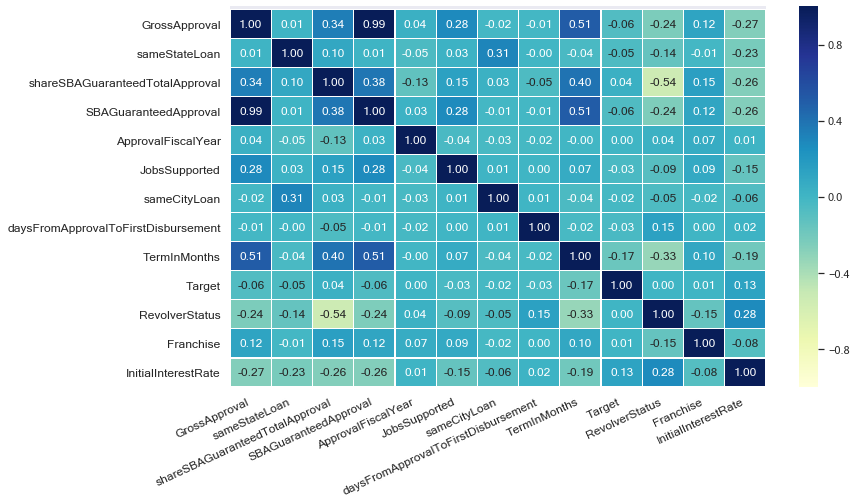

In [13]:
sns.set(font="Microsoft Sans Serif")
plt.figure(figsize=(12, 7))
ax = sns.heatmap(dados[numeric_features].corr(method='pearson'), annot = True, 
                 vmin=-1, vmax=1, center= 0, cmap= 'YlGnBu', 
                 linewidths=0.15, fmt='.2f')
# rotate xlabel 
ax.set_xticklabels(ax.get_xticklabels(), rotation=25, horizontalalignment='right')

# ax.axes.set_title("Matriz de Correlação",fontsize=20)
#ax.set_xlabel("X Label",fontsize=14)
#ax.set_ylabel("Y Label",fontsize=14)
ax.tick_params(labelsize=12)

# adjust plot
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.6)

In [44]:
fig = ax.get_figure()
fig.savefig("Slides/correlation_matrix.png", dpi=100, bbox_inches='tight')

- O tempo de duração do empréstimo tem uma alta correlação negativa com a target (-17%)
- O tempo de duração do empréstimo está diretamente relacionado com o valor total do empréstimo (51%), bem como o quanto o SBA garante sobre o valor (51%).
- A taxa de juros inicial está ligada com a target, 13%. E tem correlação negativa com o quanto o SBA garante sobre o empréstimo (26%) e o tempo de duração do empréstimo (-19%)

- *RevolverStatus* tem uma correlação negativa com o tempo de duração do empréstimo (-33%) e o quanto o SBA garante sobre o empréstimo (-54%). Essa métrica diz se o empréstimo foi a prazo (term) ou rotativo (revolving).

### 2.6 Visualização

In [14]:
dados.head(5)

,BorrCity,BorrState,BorrZip,BankName,BankCity,BankState,BankZip,GrossApproval,SBAGuaranteedApproval,ApprovalDate,ApprovalFiscalYear,FirstDisbursementDate,DeliveryMethod,subpgmdesc,InitialInterestRate,TermInMonths,NaicsCode,NaicsDescription,FranchiseCode,FranchiseName,ProjectCounty,ProjectState,SBADistrictOffice,CongressionalDistrict,BusinessType,RevolverStatus,JobsSupported,Target,sameStateLoan,sameCityLoan,shareSBAGuaranteedTotalApproval,daysFromApprovalToFirstDisbursement,Franchise,NaicsSector,NaicsSectorDescription
0,denver,CO,80237,"Zions Bank, A Division of",salt lake city,UT,84133,250000,125000,2009-10-01,2010,2009-10-01,SBA EXPRES,FA$TRK (Small Loan Express),5.26,84,531210.0,Offices of Real Estate Agents and Brokers,None,None,DENVER,CO,COLORADO DISTRICT OFFICE,1.0,CORPORATION,1,35,0,0,0,0.50,0.00,0,53,Real Estate and Rental and Leasing
1,sacramento,CA,95819,Plumas Bank,quincy,CA,95971,233500,210150,2009-10-01,2010,2009-10-01,PLP,Guaranty,6.00,120,722410.0,Drinking Places (Alcoholic Beverages),None,None,SACRAMENTO,CA,SACRAMENTO DISTRICT OFFICE,6.0,CORPORATION,0,6,0,1,0,0.90,0.00,0,72,Accommodation and Food Services
2,west sacramento,CA,95691,"Wells Fargo Bank, National Association",sioux falls,SD,57104,683900,615510,2009-10-01,2010,2009-11-01,PLP,Guaranty,5.25,210,811192.0,Car Washes,None,None,YOLO,CA,SACRAMENTO DISTRICT OFFICE,3.0,CORPORATION,0,27,1,0,0,0.90,31.00,0,81,Other Services (except Public Administration)
3,middlebury,IN,46540,"VelocitySBA, LLC",rancho cucamonga,CA,91730,12500,11250,2009-10-01,2010,2009-10-01,COMM EXPRS,Community Express,7.75,120,811121.0,"Automotive Body, Paint, and Interior Repair an...",None,None,ELKHART,IN,INDIANA DISTRICT OFFICE,2.0,INDIVIDUAL,0,2,0,0,0,0.90,0.00,0,81,Other Services (except Public Administration)
4,camden,TN,38320,"VelocitySBA, LLC",rancho cucamonga,CA,91730,10000,9000,2009-10-01,2010,2009-10-01,COMM EXPRS,Community Express,7.24,120,453220.0,"Gift, Novelty, and Souvenir Stores",None,None,BENTON,TN,TENNESSEE DISTRICT OFFICE,7.0,INDIVIDUAL,0,3,0,0,0,0.90,0.00,0,45,Retail Trade


#### Setores

In [15]:
grouped = dados.groupby(dados["NaicsSectorDescription"]).mean()[['GrossApproval','SBAGuaranteedApproval', 'TermInMonths', 'daysFromApprovalToFirstDisbursement']]
grouped = grouped.sort_values(by='GrossApproval', ascending=False)
grouped

,GrossApproval,SBAGuaranteedApproval,TermInMonths,daysFromApprovalToFirstDisbursement
NaicsSectorDescription,,,,
Real Estate and Rental and Leasing,480805.26,362432.68,146.10,49.45
Management of Companies and Enterprises,479063.05,343252.28,136.05,52.13
"Agriculture, Forestry, Fishing and Hunting",464410.62,359314.13,103.95,53.52
Accommodation and Food Services,459877.24,347443.72,127.56,52.14
Wholesale Trade,457419.62,352708.08,96.47,45.68
Manufacturing,430577.49,327013.75,98.45,49.57
"Mining, Quarrying, and Oil and Gas Extraction",426412.34,317636.94,74.72,44.61
Health Care and Social Assistance,341827.63,254721.43,119.07,52.45
Finance and Insurance,327061.82,242526.94,106.68,43.87


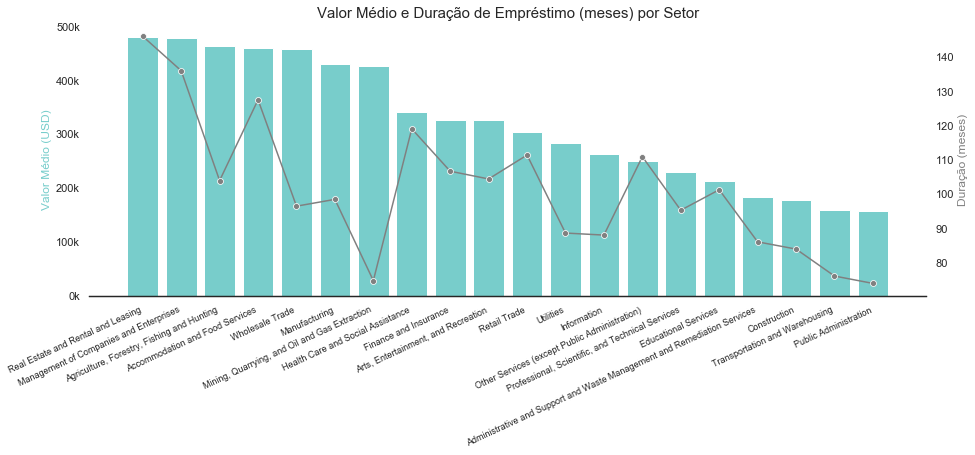

In [17]:
ax = plotBar(x=grouped.index, y='GrossApproval', data=grouped, 
             title='Valor Médio e Duração de Empréstimo (meses) por Setor', 
             xlabel='', ylabel='Valor Médio (USD)', rotation_x=25, annotation=False)
ax.tick_params(axis='y', color='white')
ax2 = ax.twinx()
ax2 = sns.lineplot(x=grouped.index, y='TermInMonths', data = grouped, sort=False, color='gray', marker="o")
ax2.set_ylabel('Duração (meses)', fontsize=12, color='gray')
ax2.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [53]:
fig = ax.get_figure()
fig.savefig("Slides/setores_valor_e_duracao.png", dpi=100, bbox_inches='tight')

- O setor de `Imóveis, Aluguel e Locação` (*Real Estate, Rental and Leasing*) tem o maior valor médio de empréstimo (481k USD) e maior tempo de duração (146 meses). `Mineração, Extração, Óleo` (*Mining, Quarrying and Oil*) é um dos setores com menor tempo de duração média do empréstimo, 75 meses.  

In [54]:
# dados.groupby('NaicsSectorDescription')['Target'].agg(['sum','count'])
target = dados.groupby('NaicsSectorDescription').agg({'Target': ['sum','count']})
target['share not paid full'] = (target['Target']['sum']/target['Target']['count'])*100
target.columns = [' '.join(col).strip() for col in target.columns.values]
target = target.reset_index()
target = target.sort_values(by='Target count', ascending=False)
target['Share Setor (%)'] = target['Target count'].div(target['Target count'].sum(), axis=0).multiply(100)
target#.head(5)

,NaicsSectorDescription,Target sum,Target count,share not paid full,Share Setor (%)
16,Retail Trade,3150,29737,10.59,13.70
0,Accommodation and Food Services,2457,26086,9.42,12.02
4,Construction,1990,23357,8.52,10.76
13,"Professional, Scientific, and Technical Services",1742,22987,7.58,10.59
7,Health Care and Social Assistance,1179,19993,5.90,9.21
10,Manufacturing,1347,18467,7.29,8.51
12,Other Services (except Public Administration),1592,17588,9.05,8.11
19,Wholesale Trade,1233,13360,9.23,6.16
17,Transportation and Warehousing,1117,11696,9.55,5.39
1,Administrative and Support and Waste Managemen...,840,9884,8.50,4.56


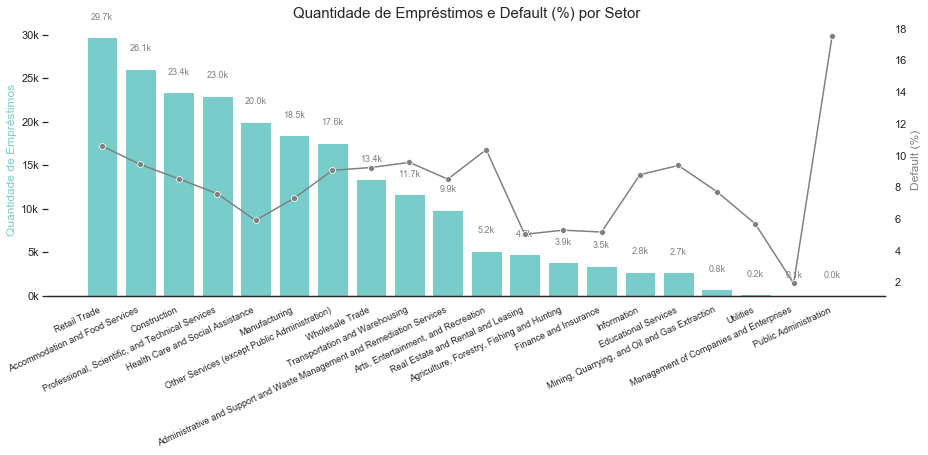

In [55]:
ax = plotBar(x=target.NaicsSectorDescription, y='Target count', data=target, 
             title='Quantidade de Empréstimos e Default (%) por Setor', 
             xlabel='', ylabel='Quantidade de Empréstimos', rotation_x=25, annotation=False,
             y_is_k=True)
for p in ax.patches:  
    ax.annotate('{:,.1f}'.format(p.get_height()/1000) + 'k',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', 
                va='center', 
                fontsize=9,
                color='gray',
                xytext=(0, 20),
                textcoords='offset points')
ax2 = ax.twinx()
ax2 = sns.lineplot(x=target['NaicsSectorDescription'], y='share not paid full', data = target, sort=False, color='gray', marker="o")
ax2.set_ylabel('Default (%)', fontsize=12, color='gray')
ax2.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [56]:
fig = ax.get_figure()
fig.savefig("Slides/setores_volume_e_default.png", dpi=100, bbox_inches='tight')

- `Comércio` (*Retail Trade*), `Acomodação e Alimentação` (*Acommodation and Food Services*) e `Construção` (*Constructions*) foram os setores que mais realizaram empréstimos, representando 36.5% dos empréstimos (13.7+12.02+10.76)
- `Administração Pública` (*Public Administration*) teve a maior taxa de default (17.5%) porém ela representou uma pequena parcela dos empréstimos (0.02%). A taxa de default para comércio foi de 10.6%. Nos top 5 maiores setores em volume de empréstimos, `Planos de Saúde e Assistência Social` (*Health Care and Social Assistance*) teve o menor taxa de default, 5.9%.

#### Estado

In [57]:
target_state = dados.groupby('ProjectState').agg({'Target': ['sum','count']})
target_state['share not paid full'] = target_state['Target']['sum']/target_state['Target']['count']
target_state.columns = [' '.join(col).strip() for col in target_state.columns.values]
target_state = target_state.reset_index()
target_state = target_state.sort_values(by='Target count', ascending=False)
target_state['Share Estado (%)'] = target_state['Target count'].div(target_state['Target count'].sum(), axis=0).multiply(100)
target_state.head(5)

,ProjectState,Target sum,Target count,share not paid full,Share Estado (%)
4,CA,2261,26947,0.08,12.42
48,TX,1859,16212,0.11,7.47
38,NY,1148,13469,0.09,6.21
39,OH,974,12499,0.08,5.76
9,FL,1056,8669,0.12,4.00


In [58]:
12.42+7.47+6.21

26.1

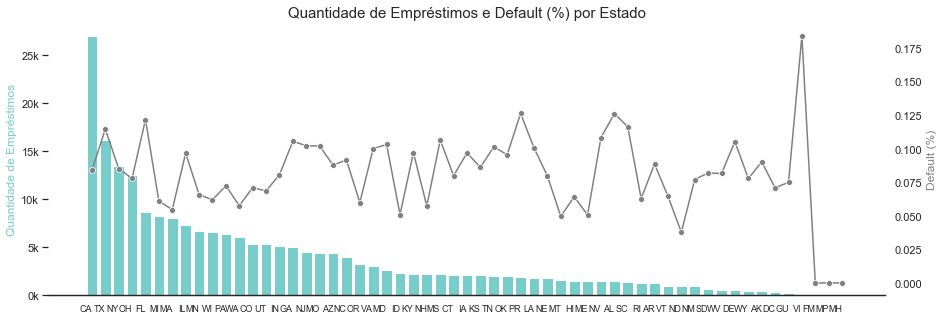

In [65]:
ax = plotBar(x=target_state.ProjectState, y='Target count', data=target_state, 
             title='Quantidade de Empréstimos e Default (%) por Estado', 
             xlabel='', ylabel='Quantidade de Empréstimos', rotation_x=0, annotation=False,
             y_is_k=True, figsize=(15,5))

ax2 = ax.twinx()
ax2 = sns.lineplot(x=target_state['ProjectState'], y='share not paid full', data = target_state, sort=False, color='gray', marker="o")
ax2.set_ylabel('Default (%)', fontsize=12, color='gray')
ax2.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [61]:
fig = ax.get_figure()
fig.savefig("Slides/estado_volume_e_default.png", dpi=80, bbox_inches='tight')

In [44]:
target_state = target_state.sort_values(by='share not paid full', ascending=False)
target_state.head(5)

,ProjectState,Target sum,Target count,share not paid full,Share Estado (%)
51,VI,7,38,0.18,0.02
43,PR,237,1875,0.13,0.86
1,AL,185,1466,0.13,0.68
9,FL,1056,8669,0.12,4.00
45,SC,162,1391,0.12,0.64


- CA (12.4%), TX (7.5%) e NY (6.2%) foram os estados com maior volume de empréstimos (26%)
- PR, AL e FL foram os estado com o maior percentual de default (13%, 13% e 12% respectivamente).

#### **Tipo de Negócio**

In [71]:
bus = dados.groupby('BusinessType').GrossApproval.describe().transpose().reset_index()
bus.to_csv("Slides/business_type_distribution.csv")
bus

BusinessType,index,CORPORATION,INDIVIDUAL,PARTNERSHIP
0,count,187247.00,25932.00,3807.00
1,mean,333084.01,154263.41,459754.12
2,std,615462.88,373434.08,752279.13
3,min,1000.00,2300.00,3000.00
4,25%,40000.00,17200.00,50000.00
5,50%,100000.00,33700.00,150000.00
6,75%,331300.00,100000.00,500000.00
7,max,5000000.00,5000000.00,5000000.00


In [66]:
plt.figure(figsize=(15, 5))
fig = plot_boxplot(df=dados, x="BusinessType", y="GrossApproval", 
                   title="Comparação de Valor Total do Empréstimo por Tipo de Negócio", 
                   x_title="Tipo de Negócio", y_title="Total Empréstimo",
                   width=600, height=750)
fig.show()

<Figure size 1080x360 with 0 Axes>

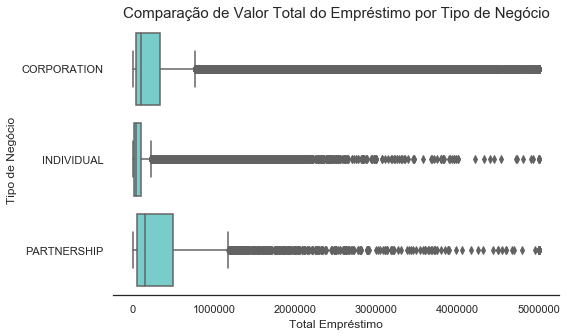

In [69]:
plt.figure(figsize=(8, 5))
ax = sns.boxplot( y=dados['BusinessType'], x=dados['GrossApproval'], color=c("verde_fia"))
ax.set_ylabel('Tipo de Negócio', fontsize=12)
ax.set_xlabel('Total Empréstimo', fontsize=12)
ax.axes.set_title('Comparação de Valor Total do Empréstimo por Tipo de Negócio',fontsize=15)
ax.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [68]:
fig = ax.get_figure()
fig.savefig("Slides/business_type_boxplot.png", dpi=100, bbox_inches='tight')

In [72]:
businessType = dados.groupby('BusinessType').agg({'Target': ['sum','count']})
businessType['share not paid full'] = (businessType['Target']['sum']/businessType['Target']['count'])*100
businessType.columns = [' '.join(col).strip() for col in businessType.columns.values]
businessType = businessType.reset_index()
businessType = businessType.sort_values(by='Target count', ascending=False)
businessType['Share BusinessType (%)'] = businessType['Target count'].div(businessType['Target count'].sum(), axis=0).multiply(100)
businessType.head(5)

,BusinessType,Target sum,Target count,share not paid full,Share BusinessType (%)
0,CORPORATION,15470,187247,8.26,86.29
1,INDIVIDUAL,2695,25932,10.39,11.95
2,PARTNERSHIP,215,3807,5.65,1.75


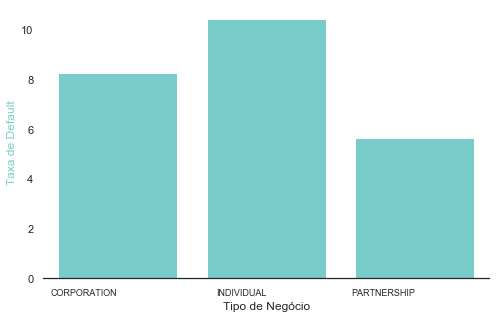

In [73]:
# Taxa de Default por tipo de Negócio
ax = plotBar(x=businessType.BusinessType, y='share not paid full', data=businessType, 
             title='', figsize=(8, 5),
             xlabel='Tipo de Negócio', ylabel='Taxa de Default', rotation_x=0, annotation=False, y_is_k=False)

In [74]:
fig = ax.get_figure()
fig.savefig("Slides/business_type_barplot_default.png", dpi=80, bbox_inches='tight')

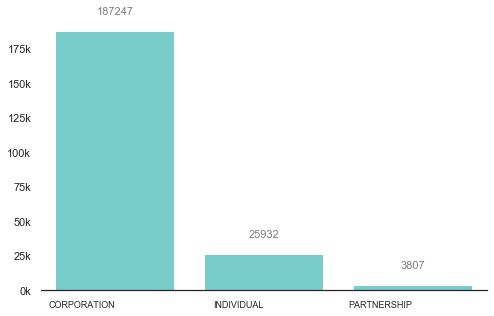

In [75]:
# Volume de Empréstimos por Tipo de Negócio
ax = plotBar(x=businessType.BusinessType, y='Target count', data=businessType, 
             title='', figsize=(8, 5),
             xlabel='', ylabel='', rotation_x=0, annotation=True)

In [76]:
fig = ax.get_figure()
fig.savefig("Slides/business_type_barplot_volume.png", dpi=80, bbox_inches='tight')

86% dos empréstimos foram de negócios do tipo `Corporação`, com mediana de 333k USD e desvio padrão de 615k USD. Apesar dos empréstimos do tipo `Parceria` serem apenas 1.75% dos empréstimos, vemos que a mediana é a maior entre os três tipos (460k USD).
Já empréstimos `Individuais` representaram 11.95% da base e tiveram a menor mediana (154k USD), como esperado. Além disso, a taxa de default foi a maior (10.4% dos empréstimos não foram pagos), versus uma taxa de default de 5.65% para `Parceria` e 8.26% para `Corporação`.

#### **Taxa de Juros**
(InitialInterestRate)

In [50]:
dados.groupby('BusinessType').InitialInterestRate.describe().reset_index()

,BusinessType,count,mean,std,min,25%,50%,75%,max
0,CORPORATION,187247.00,6.26,1.39,0.00,5.45,6.00,7.00,12.50
1,INDIVIDUAL,25932.00,6.79,1.60,0.00,5.65,6.40,7.99,12.00
2,PARTNERSHIP,3807.00,6.15,1.21,1.81,5.50,6.00,6.50,11.00


In [51]:
# plt.figure(figsize=(15, 5))
# ax = sns.boxplot( y=dados['BusinessType'], x=dados['InitialInterestRate'], color=c("verde_fia"))
# ax.set_ylabel('Tipo de Negócio', fontsize=12)
# ax.set_xlabel('Taxa de Juros Inicial', fontsize=12)
# ax.axes.set_title('Comparação da Taxa de Juros Inicial por Tipo de Negócio',fontsize=15)
# ax.tick_params(axis='y', color='white')
# sns.set_style("white")
# sns.despine(left=True)

In [77]:
fig = plot_boxplot(df=dados, x="BusinessType", y="InitialInterestRate", 
             title="Comparação Taxa de Juros Inicial por Tipo de Negócio", 
             x_title="Tipo de Negócio", y_title="Taxa de Juros Inicial (%)")
fig.show()

In [80]:
# TO DO: conda install -c plotly plotly-orca | Salvar plotly
fig.write_image("Slides/business_type_boxplot_juros.png")

- A taxa média inicial de juros varia conforme o tipo de negócio. Vemos que a distribuição dos juros para negócios do tipo Individual é maior do que Corporação (Corporations) e Parceria (Partnership).
- A taxa média de juros média foi de 6.15% para parceria, 6.26% para corporação e 6.79% para individual.

In [82]:
subpgmdesc = dados.groupby('subpgmdesc').InitialInterestRate.describe().reset_index().sort_values(by='count', ascending=False)
subpgmdesc['subpgmdesc (%)'] = subpgmdesc['count'].div(subpgmdesc['count'].sum(), axis=0).multiply(100)
subpgmdesc

,subpgmdesc,count,mean,std,min,25%,50%,75%,max,subpgmdesc (%)
5,FA$TRK (Small Loan Express),118602.00,6.72,1.65,1.25,5.50,6.50,7.75,12.50,54.66
6,Guaranty,69420.00,5.72,0.70,1.00,5.25,5.95,6.00,10.36,31.99
9,Lender Advantage Initiative,11830.00,5.70,0.77,1.57,5.25,5.75,6.00,9.64,5.45
10,Patriot Express,4532.00,6.35,1.04,1.82,5.50,6.00,7.25,10.41,2.09
2,Community Express,4055.00,7.46,0.70,3.25,7.50,7.75,7.75,9.61,1.87
12,Rural Lender Advantage,2162.00,6.09,0.71,3.25,5.75,6.00,6.00,9.71,1.00
16,Standard Asset Based,1470.00,5.17,0.77,2.25,4.75,5.25,5.50,8.00,0.68
7,Gulf Opportunity,1320.00,6.55,0.95,3.00,6.00,6.50,7.25,9.75,0.61
11,Revolving Line of Credit Exports - Sec. 7(a) (14),1277.00,5.17,1.29,1.50,4.25,5.25,6.00,10.00,0.59
1,Community Advantage Initiative,1262.00,7.60,1.15,0.00,7.25,7.50,8.25,10.75,0.58


In [57]:
54.66+31.99

86.64999999999999

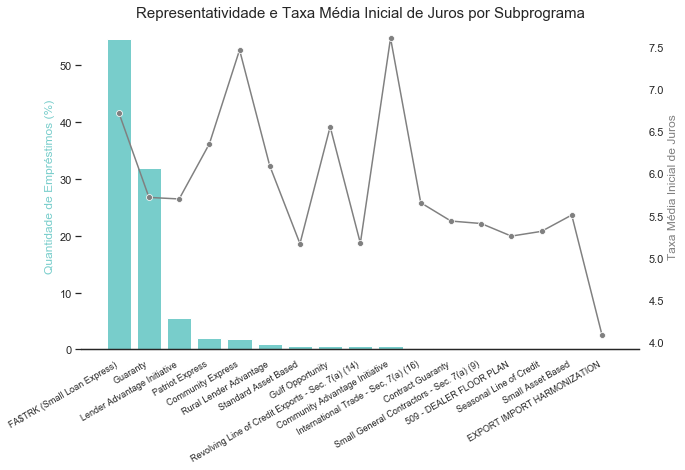

In [83]:
ax = plotBar(x=subpgmdesc.subpgmdesc, y='subpgmdesc (%)', data=subpgmdesc, 
             title='Representatividade e Taxa Média Inicial de Juros por Subprograma', 
             xlabel='', ylabel='Quantidade de Empréstimos (%)', rotation_x=30, annotation=False,
             y_is_k=False, figsize=(10,6))

ax2 = ax.twinx()
ax2 = sns.lineplot(x=subpgmdesc['subpgmdesc'], y='mean', data = subpgmdesc, sort=False, color='gray', marker="o")
ax2.set_ylabel('Taxa Média Inicial de Juros', fontsize=12, color='gray')
ax2.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [84]:
fig = ax.get_figure()
fig.savefig("Slides/subprogram_barplot_juros.png", dpi=80, bbox_inches='tight')

In [56]:
# plt.figure(figsize=(15, 5))
# filtered = subpgmdesc['subpgmdesc'].head(2).tolist() # show only two main subprograms
# dados_filtered = dados[dados['subpgmdesc'].isin(filtered)]
# ax = sns.boxplot( y=dados_filtered['subpgmdesc'], x=dados_filtered['InitialInterestRate'], color=c("verde_fia"))
# ax.set_ylabel('Descrição do subprograma', fontsize=12)
# ax.set_xlabel('Taxa de Juros Inicial', fontsize=12)
# ax.tick_params(axis='y', color='white')
# sns.set_style("white")
# sns.despine(left=True)

In [85]:
filtered = subpgmdesc['subpgmdesc'].head(2).tolist() # show only two main subprograms
dados_filtered = dados[dados['subpgmdesc'].isin(filtered)]
fig = plot_boxplot(df=dados_filtered, x="subpgmdesc", y="InitialInterestRate",
             title="Comparação Taxa de Juros Inicial por Subprograma",
             x_title="Subprograma", y_title="Taxa de Juros Inicial (%)",
                  width=600, height=400)
fig.show()

In [86]:
# TO DO: conda install -c plotly plotly-orca | Salvar plotly
fig.write_image("Slides/subprogram_boxplot_juros.png")

- Os subprogramas do tipo FA$TRK (Small Loan Express) e Guaranty representaram +86% dos empréstimos. Vemos uma grande diferença entre as taxas de juros iniciais. 
- Comparando ambas, a média de Small Loan Express é de 6.72% com um desvio de 1.65 enquanto que Guaranty teve média de 5.72% com um desvio de 0.7.

#### RevolverStatus
Indicador quando o empréstimo é a prazo ou linha de crédito rotativo
(0 = prazo, 1 = rotativo)

In [17]:
dados.columns

Index(['BorrCity', 'BorrState', 'BorrZip', 'BankName', 'BankCity', 'BankState',
       'BankZip', 'GrossApproval', 'SBAGuaranteedApproval', 'ApprovalDate',
       'ApprovalFiscalYear', 'FirstDisbursementDate', 'DeliveryMethod',
       'subpgmdesc', 'InitialInterestRate', 'TermInMonths', 'NaicsCode',
       'NaicsDescription', 'FranchiseCode', 'FranchiseName', 'ProjectCounty',
       'ProjectState', 'SBADistrictOffice', 'CongressionalDistrict',
       'BusinessType', 'RevolverStatus', 'JobsSupported', 'Target',
       'sameStateLoan', 'sameCityLoan', 'shareSBAGuaranteedTotalApproval',
       'daysFromApprovalToFirstDisbursement', 'Franchise', 'NaicsSector',
       'NaicsSectorDescription'],
      dtype='object')

In [14]:
revolver = dados.groupby('RevolverStatus')['Target'].agg(['sum','count'])
revolver = revolver.rename(columns={'sum': 'default', 'count':'count_emprestimos'})
revolver['default (%)'] = revolver['default'] / revolver['count_emprestimos']
revolver

,default,count_emprestimos,default (%)
RevolverStatus,,,
0,11931,141952,0.084050
1,6449,75037,0.085944


65% dos empréstimos foram a prazo (status = 0). A taxa de default para empréstimos rotativos foi de 8.6% vs 8.4 para a prazo.

In [20]:
revolver = dados.groupby(['RevolverStatus', 'BusinessType'])['Target'].agg(['sum','count'])
revolver = revolver.rename(columns={'sum': 'default', 'count':'count_emprestimos'})
revolver['default (%)'] = revolver['default'] / revolver['count_emprestimos']
revolver

default  count_emprestimos  default (%)
RevolverStatus BusinessType                                         
0              CORPORATION     10276             122213     0.084083
               INDIVIDUAL       1508              16895     0.089257
               PARTNERSHIP       147               2841     0.051742
1              CORPORATION      5194              65034     0.079866
               INDIVIDUAL       1187               9037     0.131349
               PARTNERSHIP        68                966     0.070393

In [25]:
revolver = dados.groupby('RevolverStatus').Target.describe().reset_index().sort_values(by='count', ascending=False)
revolver['revolver (%)'] = revolver['count'].div(revolver['count'].sum(), axis=0).multiply(100)
revolver

,RevolverStatus,count,mean,std,min,25%,50%,75%,max,revolver (%)
0,0,141952.0,0.084050,0.277463,0.0,0.0,0.0,0.0,1.0,65.418984
1,1,75037.0,0.085944,0.280284,0.0,0.0,0.0,0.0,1.0,34.581016


#### Loan Duration vs Default Rate
Quanto maior a duração do empréstimo, menor a taxa de default (correlação negativa)

In [19]:
dados.TermInMonths.describe()

count   216989.00
mean       104.08
std         73.26
min          0.00
25%         60.00
50%         84.00
75%        120.00
max        360.00
Name: TermInMonths, dtype: float64

In [34]:
dados_bin = dados[['TermInMonths', 'Target']]
bins = [0, 20, 40, 60, 80, 100, 120, 360]
dados_bin['binned'] = pd.cut(dados_bin['TermInMonths'], bins)
dados_bin = dados_bin.groupby('binned').Target.agg(['sum','count'])
dados_bin['default'] = dados_bin['sum'] / dados_bin['count']
dados_bin

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,sum,count,default
binned,,,
"(0, 20]",2415,8691,0.28
"(20, 40]",3199,12884,0.25
"(40, 60]",4328,39100,0.11
"(60, 80]",3508,10313,0.34
"(80, 100]",2270,80041,0.03
"(100, 120]",1629,32665,0.05
"(120, 360]",957,33215,0.03


## 3. Tratamento dos Dados
Imputação, dummies. Geracao da ABT de modelagem

In [9]:
dados.shape

(216989, 35)

In [10]:
dados.head()

,BorrCity,BorrState,BorrZip,BankName,BankCity,BankState,BankZip,GrossApproval,SBAGuaranteedApproval,ApprovalDate,ApprovalFiscalYear,FirstDisbursementDate,DeliveryMethod,subpgmdesc,InitialInterestRate,TermInMonths,NaicsCode,NaicsDescription,FranchiseCode,FranchiseName,ProjectCounty,ProjectState,SBADistrictOffice,CongressionalDistrict,BusinessType,RevolverStatus,JobsSupported,Target,sameStateLoan,sameCityLoan,shareSBAGuaranteedTotalApproval,daysFromApprovalToFirstDisbursement,Franchise,NaicsSector,NaicsSectorDescription
0,denver,CO,80237,"Zions Bank, A Division of",salt lake city,UT,84133,250000,125000,2009-10-01,2010,2009-10-01,SBA EXPRES,FA$TRK (Small Loan Express),5.26,84,531210.0,Offices of Real Estate Agents and Brokers,None,None,DENVER,CO,COLORADO DISTRICT OFFICE,1.0,CORPORATION,1,35,0,0,0,0.5,0.0,0,53,Real Estate and Rental and Leasing
1,sacramento,CA,95819,Plumas Bank,quincy,CA,95971,233500,210150,2009-10-01,2010,2009-10-01,PLP,Guaranty,6.00,120,722410.0,Drinking Places (Alcoholic Beverages),None,None,SACRAMENTO,CA,SACRAMENTO DISTRICT OFFICE,6.0,CORPORATION,0,6,0,1,0,0.9,0.0,0,72,Accommodation and Food Services
2,west sacramento,CA,95691,"Wells Fargo Bank, National Association",sioux falls,SD,57104,683900,615510,2009-10-01,2010,2009-11-01,PLP,Guaranty,5.25,210,811192.0,Car Washes,None,None,YOLO,CA,SACRAMENTO DISTRICT OFFICE,3.0,CORPORATION,0,27,1,0,0,0.9,31.0,0,81,Other Services (except Public Administration)
3,middlebury,IN,46540,"VelocitySBA, LLC",rancho cucamonga,CA,91730,12500,11250,2009-10-01,2010,2009-10-01,COMM EXPRS,Community Express,7.75,120,811121.0,"Automotive Body, Paint, and Interior Repair an...",None,None,ELKHART,IN,INDIANA DISTRICT OFFICE,2.0,INDIVIDUAL,0,2,0,0,0,0.9,0.0,0,81,Other Services (except Public Administration)
4,camden,TN,38320,"VelocitySBA, LLC",rancho cucamonga,CA,91730,10000,9000,2009-10-01,2010,2009-10-01,COMM EXPRS,Community Express,7.24,120,453220.0,"Gift, Novelty, and Souvenir Stores",None,None,BENTON,TN,TENNESSEE DISTRICT OFFICE,7.0,INDIVIDUAL,0,3,0,0,0,0.9,0.0,0,45,Retail Trade


In [11]:
dados['ApprovalDate'].min()

Timestamp('2009-10-01 00:00:00')

In [12]:
dados['ApprovalDate'].max()

Timestamp('2019-09-30 00:00:00')

In [13]:
dados['ApprovalYear'] = dados["ApprovalDate"].dt.year

In [13]:
yearly_interest = dados.groupby('ApprovalYear').InitialInterestRate.describe().reset_index()
yearly_interest['ApprovalYear'] = yearly_interest['ApprovalYear'].apply(str)
yearly_interest = yearly_interest.rename(columns={'mean': 'mean_InitialInterestRate'}).sort_index(ascending=True)
yearly_interest = yearly_interest[['ApprovalYear','mean_InitialInterestRate']]
yearly_interest.dtypes

ApprovalYear                 object
mean_InitialInterestRate    float64
dtype: object

In [38]:
year_volume = dados.groupby('ApprovalYear').agg({'Target': ['sum','count']})
year_volume['share not paid full'] = (year_volume['Target']['sum']/year_volume['Target']['count'])
year_volume.columns = [' '.join(col).strip() for col in year_volume.columns.values]
year_volume = year_volume.reset_index()
year_volume = year_volume.sort_values(by='ApprovalYear', ascending=True)
year_volume['Share Year (%)'] = year_volume['Target count'].div(year_volume['Target count'].sum(), axis=0).multiply(100)
year_volume['ApprovalYear'] = year_volume['ApprovalYear'].apply(str)
year_volume = pd.merge(year_volume, yearly_interest, how='left', on='ApprovalYear')
year_volume

,ApprovalYear,Target sum,Target count,share not paid full,Share Year (%),mean_InitialInterestRate
0,2009,1119,9412,0.118891,4.337547,6.394472
1,2010,3621,39286,0.092170,18.105065,6.408521
2,2011,2561,32848,0.077965,15.138095,6.398631
3,2012,2121,30604,0.069305,14.103941,6.281938
4,2013,1905,26304,0.072422,12.122273,6.164802
5,2014,2202,28031,0.078556,12.918166,6.061534
6,2015,2129,22700,0.093789,10.461360,6.183162
7,2016,1610,15669,0.102751,7.221103,6.375808
8,2017,887,8717,0.101755,4.017254,6.839706
9,2018,221,3116,0.070924,1.436017,7.458418


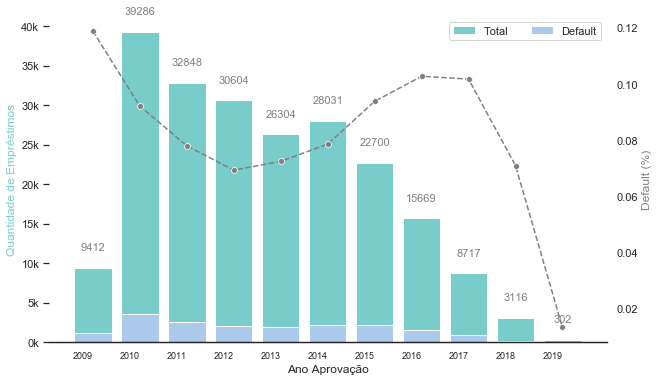

In [95]:
# Quantidade de Empréstimos e Default (%) por Ano
ax = plotBar(x=year_volume.ApprovalYear, y='Target count', data=year_volume, 
#              title='Quantidade de Empréstimos e Default (%) por Ano', 
             title='',              
             rotation_x=0, annotation=True,
             y_is_k=True, figsize=(10,6), label='Total')

sns.set_color_codes("pastel")
sns.barplot(x='ApprovalYear', y='Target sum', data=year_volume,
            label="Default", color="b")
ax.set(xlabel='Ano Aprovação', ylabel='Quantidade de Empréstimos')

# Add a legend and informative axis label
ax.legend(ncol=2, loc="upper right", frameon=True)
sns.despine(left=True, bottom=True)

ax2 = ax.twinx()
ax2 = sns.lineplot(x=year_volume['ApprovalYear'], y='share not paid full', data = year_volume, sort=False, color='gray', marker="o")
ax2.lines[0].set_linestyle("--")
ax2.set_ylabel('Default (%)', fontsize=12, color='gray')
ax2.tick_params(axis='y', color='white')
sns.set_style("white")
sns.despine(left=True)

In [96]:
fig = ax.get_figure()
fig.savefig("Slides/yearly_barplot_volume_default.png", dpi=80, bbox_inches='tight')

In [63]:
dados['ApprovalDate'].min()

Timestamp('2009-10-01 00:00:00')

In [64]:
dados['ApprovalDate'].max()

Timestamp('2019-09-30 00:00:00')

### Removendo colunas não usadas

- Colunas com alta cardinalidade
- Colunas com datas
- Colunas que foram base para as variáveis criadas

In [14]:
dados.apply(pd.Series.nunique).sort_values()

Franchise                                  2
sameCityLoan                               2
sameStateLoan                              2
Target                                     2
RevolverStatus                             2
BusinessType                               3
ApprovalFiscalYear                        10
ApprovalYear                              11
DeliveryMethod                            15
subpgmdesc                                17
NaicsSectorDescription                    20
NaicsSector                               25
CongressionalDistrict                     54
BankState                                 54
ProjectState                              57
BorrState                                 57
SBADistrictOffice                         74
JobsSupported                            284
TermInMonths                             325
shareSBAGuaranteedTotalApproval          783
NaicsDescription                        1175
NaicsCode                               1201
InitialInt

In [15]:
dados.columns

Index(['BorrCity', 'BorrState', 'BorrZip', 'BankName', 'BankCity', 'BankState',
       'BankZip', 'GrossApproval', 'SBAGuaranteedApproval', 'ApprovalDate',
       'ApprovalFiscalYear', 'FirstDisbursementDate', 'DeliveryMethod',
       'subpgmdesc', 'InitialInterestRate', 'TermInMonths', 'NaicsCode',
       'NaicsDescription', 'FranchiseCode', 'FranchiseName', 'ProjectCounty',
       'ProjectState', 'SBADistrictOffice', 'CongressionalDistrict',
       'BusinessType', 'RevolverStatus', 'JobsSupported', 'Target',
       'sameStateLoan', 'sameCityLoan', 'shareSBAGuaranteedTotalApproval',
       'daysFromApprovalToFirstDisbursement', 'Franchise', 'NaicsSector',
       'NaicsSectorDescription', 'ApprovalYear'],
      dtype='object')

In [16]:
dados.shape

(216989, 36)

In [16]:
# Apenas 255 empréstimos foram projetos em que o estado foi diferente. Iremos desconsiderar o ProjectState.
aux = df[['ProjectState', 'BorrState']]
aux['sameStateProject'] = np.where(aux['ProjectState'] == aux['BorrState'], 1, 0)
aux[aux['sameStateProject'] == 0].count()

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



ProjectState        702
BorrState           702
sameStateProject    702
dtype: int64

Removendo varíaveis que não fazem sentido manter:
- BorrCity: alta cardinalidade (12220 cidades) - criada variável sameCityLoan
- BorrZip: alta cardinalidade (19571 zips)
- BankName: alta cardinalidade (2751 nomes de banco)
- BankCity: alta cardinalidade (1817 cidades)
- BankZip: alta cardinalidade (3848 zips)
- ProjectCounty: alta cardinalidade (1789 municípios)
- ProjectState: altamente correlacionada com BorrState
- NaicsDescription: alta cardinalidade (1175 descrições) - criada variável NaicsSector
- NaicsCode: alta cardinalidade (1201 descrições) - criada variável NaicsSector
- FranchiseName (2183 nomes de franquias) - criado dummy para saber se foi franquia
- FranchiseCode (2491 códigos de franquia) - criado dummy para saber se foi franquia
- FirstDisbursementDate (data)
- ApprovalDate (data)
- ApprovalFiscalYear (data)
- ApprovalYear (data)
- NaicsSector - mantemos a NaicsDescription

In [17]:
excluded_variables = ['BorrCity', 'BorrZip', 'BankName', 'BankCity', 'BankZip', 'ProjectCounty', 'ProjectState', 'CongressionalDistrict',
                      'NaicsDescription', 'NaicsCode',
                      'FranchiseName', 'FranchiseCode',
                      'ApprovalDate', 'ApprovalFiscalYear', 'FirstDisbursementDate', 'ApprovalYear',
                      'NaicsSector'
                     ]

df = dados.copy()
df = df[list(set(dados.columns) - set(excluded_variables))]
df.head()

,DeliveryMethod,TermInMonths,BorrState,BankState,SBAGuaranteedApproval,daysFromApprovalToFirstDisbursement,JobsSupported,NaicsSectorDescription,Franchise,shareSBAGuaranteedTotalApproval,GrossApproval,RevolverStatus,InitialInterestRate,SBADistrictOffice,subpgmdesc,sameStateLoan,BusinessType,Target,sameCityLoan
0,SBA EXPRES,84,CO,UT,125000,0.0,35,Real Estate and Rental and Leasing,0,0.5,250000,1,5.26,COLORADO DISTRICT OFFICE,FA$TRK (Small Loan Express),0,CORPORATION,0,0
1,PLP,120,CA,CA,210150,0.0,6,Accommodation and Food Services,0,0.9,233500,0,6.00,SACRAMENTO DISTRICT OFFICE,Guaranty,1,CORPORATION,0,0
2,PLP,210,CA,SD,615510,31.0,27,Other Services (except Public Administration),0,0.9,683900,0,5.25,SACRAMENTO DISTRICT OFFICE,Guaranty,0,CORPORATION,1,0
3,COMM EXPRS,120,IN,CA,11250,0.0,2,Other Services (except Public Administration),0,0.9,12500,0,7.75,INDIANA DISTRICT OFFICE,Community Express,0,INDIVIDUAL,0,0
4,COMM EXPRS,120,TN,CA,9000,0.0,3,Retail Trade,0,0.9,10000,0,7.24,TENNESSEE DISTRICT OFFICE,Community Express,0,INDIVIDUAL,0,0


In [18]:
df.shape

(216989, 19)

### Tratamento de Nulos

Removendo nulos. Como o maior número de registros nulos é 868, optou-se por remover as linhas.

In [19]:
df.isnull().sum()

DeliveryMethod                           0
TermInMonths                             0
BorrState                                0
BankState                                1
SBAGuaranteedApproval                    0
daysFromApprovalToFirstDisbursement    868
JobsSupported                            0
NaicsSectorDescription                   7
Franchise                                0
shareSBAGuaranteedTotalApproval          0
GrossApproval                            0
RevolverStatus                           0
InitialInterestRate                      0
SBADistrictOffice                        0
subpgmdesc                               0
sameStateLoan                            0
BusinessType                             3
Target                                   0
sameCityLoan                             0
dtype: int64

In [20]:
df = df.dropna()
df.isnull().sum()

DeliveryMethod                         0
TermInMonths                           0
BorrState                              0
BankState                              0
SBAGuaranteedApproval                  0
daysFromApprovalToFirstDisbursement    0
JobsSupported                          0
NaicsSectorDescription                 0
Franchise                              0
shareSBAGuaranteedTotalApproval        0
GrossApproval                          0
RevolverStatus                         0
InitialInterestRate                    0
SBADistrictOffice                      0
subpgmdesc                             0
sameStateLoan                          0
BusinessType                           0
Target                                 0
sameCityLoan                           0
dtype: int64

In [21]:
df.shape

(216110, 19)

### Valores negativos

`daysFromApprovalToFirstDisbursement` com valores negativos não fazem muito sentido. Temos 665 casos nessa situação. Optamos por remover.

In [21]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Target,216110.0,0.084998,0.278880,0.00,0.0,0.0,0.00,1.00
sameCityLoan,216110.0,0.074050,0.261853,0.00,0.0,0.0,0.00,1.00
sameStateLoan,216110.0,0.454440,0.497921,0.00,0.0,0.0,1.00,1.00
GrossApproval,216110.0,314587.642117,598477.338844,1000.00,30000.0,100000.0,300000.00,5000000.00
JobsSupported,216110.0,11.153237,22.120344,0.00,2.0,5.0,12.00,2150.00
InitialInterestRate,216110.0,6.322409,1.425991,0.00,5.5,6.0,7.05,12.50
Franchise,216110.0,0.068794,0.253104,0.00,0.0,0.0,0.00,1.00
shareSBAGuaranteedTotalApproval,216110.0,0.640504,0.159848,0.15,0.5,0.5,0.75,2.25
TermInMonths,216110.0,104.191389,73.355663,0.00,60.0,84.0,120.00,360.00
daysFromApprovalToFirstDisbursement,216110.0,50.129864,129.831357,-3648.00,0.0,9.0,43.00,3652.00


In [22]:
df[df['daysFromApprovalToFirstDisbursement'] < 0].count()

DeliveryMethod                         665
TermInMonths                           665
BorrState                              665
BankState                              665
SBAGuaranteedApproval                  665
daysFromApprovalToFirstDisbursement    665
JobsSupported                          665
NaicsSectorDescription                 665
Franchise                              665
shareSBAGuaranteedTotalApproval        665
GrossApproval                          665
RevolverStatus                         665
InitialInterestRate                    665
SBADistrictOffice                      665
subpgmdesc                             665
sameStateLoan                          665
BusinessType                           665
Target                                 665
sameCityLoan                           665
dtype: int64

In [23]:
df = df[df['daysFromApprovalToFirstDisbursement'] >= 0]

In [24]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
TermInMonths,215445.0,104.198635,73.364310,0.00,60.0,84.0,120.00,360.00
SBAGuaranteedApproval,215445.0,234500.976797,470560.875518,500.00,17500.0,54000.0,206250.00,5250000.00
daysFromApprovalToFirstDisbursement,215445.0,50.314943,129.751651,0.00,0.0,10.0,43.00,3652.00
JobsSupported,215445.0,11.152447,22.132467,0.00,2.0,5.0,12.00,2150.00
Franchise,215445.0,0.068913,0.253307,0.00,0.0,0.0,0.00,1.00
shareSBAGuaranteedTotalApproval,215445.0,0.640435,0.159779,0.15,0.5,0.5,0.75,2.25
GrossApproval,215445.0,314847.944942,598982.091328,1000.00,30000.0,100000.0,300000.00,5000000.00
RevolverStatus,215445.0,0.343846,0.474992,0.00,0.0,0.0,1.00,1.00
InitialInterestRate,215445.0,6.321574,1.426470,0.00,5.5,6.0,7.05,12.50
sameStateLoan,215445.0,0.454385,0.497916,0.00,0.0,0.0,1.00,1.00


In [116]:
# target = df['Target']
# train_set, test_set, y_train, y_test = train_test_split(df,
#                                                         target,
#                                                         test_size=0.3,
#                                                         random_state=42)

In [117]:
# print(train_set.shape)
# print(test_set.shape)
# print(dados.shape)

### 3.1 Imputação

Imputação de mediana nas variáveis numéricas.

Imputação de `unk` (para unknown) para as variáveis categóricas (não se aplica para essa base).

In [25]:
numerical_variables = df.describe().transpose().index.tolist()
categorical_variables = list(set(df.columns.tolist()) - set(numerical_variables))
numerical_variables.remove('Target')
print('Variveis numericas: ',numerical_variables)
print('Variveis categoricas: ',categorical_variables)

Variveis numericas:  ['TermInMonths', 'SBAGuaranteedApproval', 'daysFromApprovalToFirstDisbursement', 'JobsSupported', 'Franchise', 'shareSBAGuaranteedTotalApproval', 'GrossApproval', 'RevolverStatus', 'InitialInterestRate', 'sameStateLoan', 'sameCityLoan']
Variveis categoricas:  ['DeliveryMethod', 'subpgmdesc', 'NaicsSectorDescription', 'BorrState', 'BusinessType', 'BankState', 'SBADistrictOffice']


In [26]:
from fklearn.training.imputation import imputer, placeholder_imputer
from toolz import compose

num_impute_learner = imputer(columns_to_impute=numerical_variables,
                             impute_strategy="median")

cat_impute_learner = placeholder_imputer(columns_to_impute=categorical_variables,
                                          placeholder_value="unk")

#tupla que retorna: [0] a funcao, [1] dataset e [2] log
# num_impute_fn, _, num_impute_log = num_impute_learner(train_set)
# cat_impute_fn, _, cat_impute_log = cat_impute_learner(train_set)

#compose(num_impute_fn, cat_impute_fn)(train_set).isnull().mean()

### 3.2 Tratamento Outliers, Dummies e Label encoder
Aplica-se um **capper** para valores acima de um certo valor e o **foorer** para aplicar um threshold inferior. Não se aplica na base.

**One hot encoder** para variáveis categóricas com baixa cardinalidade.

**Label encoder** para variáveis categóricas com alta cardinalidade.

In [27]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
TermInMonths,215445.00,104.20,73.36,0.00,60.00,84.00,120.00,360.00
SBAGuaranteedApproval,215445.00,234500.98,470560.88,500.00,17500.00,54000.00,206250.00,5250000.00
daysFromApprovalToFirstDisbursement,215445.00,50.31,129.75,0.00,0.00,10.00,43.00,3652.00
JobsSupported,215445.00,11.15,22.13,0.00,2.00,5.00,12.00,2150.00
Franchise,215445.00,0.07,0.25,0.00,0.00,0.00,0.00,1.00
shareSBAGuaranteedTotalApproval,215445.00,0.64,0.16,0.15,0.50,0.50,0.75,2.25
GrossApproval,215445.00,314847.94,598982.09,1000.00,30000.00,100000.00,300000.00,5000000.00
RevolverStatus,215445.00,0.34,0.47,0.00,0.00,0.00,1.00,1.00
InitialInterestRate,215445.00,6.32,1.43,0.00,5.50,6.00,7.05,12.50
sameStateLoan,215445.00,0.45,0.50,0.00,0.00,0.00,1.00,1.00


In [28]:
categorical_variables

['DeliveryMethod',
 'subpgmdesc',
 'NaicsSectorDescription',
 'BorrState',
 'BusinessType',
 'BankState',
 'SBADistrictOffice']

In [29]:
from fklearn.training.transformation import capper, floorer
from fklearn.training.transformation import label_categorizer
from fklearn.training.transformation import onehot_categorizer

# Capping altos
capper_fn = capper(columns_to_cap=['GrossApproval', 'SBAGuaranteedApproval'], 
                   precomputed_caps={'GrossApproval': 5000000,
                                     'SBAGuaranteedApproval': 5250000
                                    })

# One hot encoding (cria dummies)
categorical_features_onehot = ['BusinessType', 'DeliveryMethod', 'subpgmdesc', 
                               'BorrState', 'BankState', 
                               'NaicsSectorDescription']
oh_encode_learner = onehot_categorizer(columns_to_categorize=categorical_features_onehot,
                                       hardcode_nans=False, # hardcodes an extra column with 1 if nan or unseen else 0
                                       drop_first_column=True)

# Label encoding
categorical_features_label_encoding = list(set(categorical_variables) - set(categorical_features_onehot))
le_encode_learner = label_categorizer(
                                columns_to_categorize=categorical_features_label_encoding,
                                store_mapping=True,
)

In [30]:
categorical_features_label_encoding

['SBADistrictOffice']

## 4. Pipeline

In [31]:
from fklearn.training.pipeline import build_pipeline

pipeline_learner = build_pipeline(
    capper_fn,
    num_impute_learner,
    cat_impute_learner,
    oh_encode_learner,
    le_encode_learner
)

In [32]:
## Using the created pipeline I transform my data
_, pre_processed_data, _ = pipeline_learner(df)

In [33]:
df.shape

(215445, 19)

In [33]:
pre_processed_data.shape

(215445, 179)

In [160]:
# using pipeline
# tupla que retorna: [0] a funcao, [1] dataset e [2] log
# p_train, train_df, log_train = pipeline_learner(train_set)
# p_test, test_df, log_test = pipeline_learner(test_set)

## 5. Métodos de Seleção
Filtro, wrapper, embedded

In [34]:
explicativas = pre_processed_data[list(set(pre_processed_data) - set(['Target']))]
target = pre_processed_data['Target']

In [35]:
explicativas.columns.tolist()

['fklearn_feat__subpgmdesc==Contract Guaranty',
 'fklearn_feat__BorrState==AZ',
 'fklearn_feat__NaicsSectorDescription==Agriculture, Forestry, Fishing and Hunting',
 'fklearn_feat__BankState==MD',
 'fklearn_feat__DeliveryMethod==PATRIOT EX',
 'fklearn_feat__BorrState==MD',
 'fklearn_feat__subpgmdesc==Lender Advantage Initiative',
 'fklearn_feat__BorrState==VT',
 'fklearn_feat__subpgmdesc==Community Advantage Initiative',
 'fklearn_feat__BankState==RI',
 'fklearn_feat__BankState==WY',
 'fklearn_feat__BankState==IL',
 'fklearn_feat__BorrState==AK',
 'fklearn_feat__DeliveryMethod==SBA EXPRES',
 'fklearn_feat__BankState==An',
 'fklearn_feat__BorrState==ND',
 'fklearn_feat__BankState==KY',
 'fklearn_feat__NaicsSectorDescription==Administrative and Support and Waste Management and Remediation Services',
 'fklearn_feat__BorrState==SD',
 'fklearn_feat__BankState==UT',
 'fklearn_feat__BorrState==IA',
 'fklearn_feat__subpgmdesc==EXPORT IMPORT HARMONIZATION',
 'fklearn_feat__NaicsSectorDescriptio

In [36]:
explicativas.shape

(215445, 178)

### 5.1 Baseado em Filtro

In [37]:
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.preprocessing import MinMaxScaler

x_norm = MinMaxScaler().fit_transform(explicativas)

# chamada do objeto
chi2_selector = SelectKBest(chi2)

chi2_selector.fit(x_norm, target)

chi_s = chi2_selector.get_support()

chi_feature = explicativas.loc[:,chi_s].columns.tolist()
print(str(len(chi_feature)), 'variaveis selecionadas')
print(chi_feature)

10 variaveis selecionadas
['fklearn_feat__DeliveryMethod==PATRIOT EX', 'fklearn_feat__BankState==AL', 'fklearn_feat__subpgmdesc==Community Express', 'fklearn_feat__DeliveryMethod==PLP', 'fklearn_feat__subpgmdesc==Patriot Express', 'fklearn_feat__BankState==OR', 'TermInMonths', 'sameStateLoan', 'fklearn_feat__BankState==SD', 'fklearn_feat__DeliveryMethod==COMM EXPRS']


### 5.2 Wrapper

In [38]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# chamada do objeto
rfe_selector = RFE(estimator=LogisticRegression(), step=10) #default is half, n_features_to_select=10)

rfe_selector.fit(explicativas, target)
rfe_support = rfe_selector.get_support()
rfe_feature = explicativas.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'variaveis selecionadas:')
print(rfe_feature)

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Spe

89 variaveis selecionadas:
['fklearn_feat__NaicsSectorDescription==Agriculture, Forestry, Fishing and Hunting', 'fklearn_feat__subpgmdesc==Lender Advantage Initiative', 'fklearn_feat__BorrState==VT', 'fklearn_feat__DeliveryMethod==SBA EXPRES', 'fklearn_feat__BorrState==ND', 'fklearn_feat__NaicsSectorDescription==Administrative and Support and Waste Management and Remediation Services', 'fklearn_feat__BorrState==NH', 'fklearn_feat__NaicsSectorDescription==Professional, Scientific, and Technical Services', 'fklearn_feat__BankState==AL', 'fklearn_feat__NaicsSectorDescription==Information', 'daysFromApprovalToFirstDisbursement', 'fklearn_feat__subpgmdesc==Community Express', 'fklearn_feat__BorrState==NY', 'fklearn_feat__BankState==DE', 'fklearn_feat__BankState==MS', 'fklearn_feat__DeliveryMethod==PLP', 'fklearn_feat__BorrState==ID', 'fklearn_feat__BankState==TX', 'fklearn_feat__BorrState==MS', 'fklearn_feat__BankState==WA', 'SBADistrictOffice', 'fklearn_feat__BorrState==WI', 'fklearn_feat_

### 5.3 Random Forest

In [39]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

em_selector = SelectFromModel(RandomForestClassifier(n_estimators=100))
em_selector.fit(explicativas, target)

em_sup = em_selector.get_support()
em_feature = explicativas.loc[:,em_sup].columns.tolist()
print(str(len(em_feature)), 'variaveis selecionadas:')
print(em_feature)

19 variaveis selecionadas:
['fklearn_feat__NaicsSectorDescription==Professional, Scientific, and Technical Services', 'daysFromApprovalToFirstDisbursement', 'SBADistrictOffice', 'fklearn_feat__NaicsSectorDescription==Manufacturing', 'GrossApproval', 'fklearn_feat__BankState==OH', 'TermInMonths', 'fklearn_feat__NaicsSectorDescription==Other Services (except Public Administration)', 'fklearn_feat__NaicsSectorDescription==Retail Trade', 'sameStateLoan', 'JobsSupported', 'fklearn_feat__NaicsSectorDescription==Accommodation and Food Services', 'InitialInterestRate', 'SBAGuaranteedApproval', 'fklearn_feat__BankState==SD', 'RevolverStatus', 'fklearn_feat__NaicsSectorDescription==Construction', 'shareSBAGuaranteedTotalApproval', 'fklearn_feat__BusinessType==CORPORATION']


### 5.4 Comparando Filtro, Wrapper e Random Forest

In [40]:
feature_selection_df = pd.DataFrame({'Variaveis':explicativas.columns,
                                     'chi2':chi_s,
                                     'RFE': rfe_support,
                                     'Random forest': em_sup})
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
feature_selection_df = feature_selection_df.sort_values(['Total', 'Variaveis'], ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)

In [41]:
modelagem_selected = feature_selection_df[feature_selection_df['Total'] > 1]
modelagem_selected

,Variaveis,chi2,RFE,Random forest,Total
1,sameStateLoan,True,True,True,3
2,fklearn_feat__BankState==SD,True,True,True,3
3,TermInMonths,True,True,True,3
4,shareSBAGuaranteedTotalApproval,False,True,True,2
5,fklearn_feat__subpgmdesc==Community Express,True,True,False,2
6,fklearn_feat__NaicsSectorDescription==Retail T...,False,True,True,2
7,fklearn_feat__NaicsSectorDescription==Professi...,False,True,True,2
8,fklearn_feat__NaicsSectorDescription==Other Se...,False,True,True,2
9,fklearn_feat__NaicsSectorDescription==Manufact...,False,True,True,2
10,fklearn_feat__NaicsSectorDescription==Construc...,False,True,True,2


In [42]:
# modelagem_selected.to_csv('Slides/modelagem_selected.csv')
modelagem_selected.to_csv('Slides/entrega2_v2/modelagem_selected_v2.csv')

Selecionando features que apareceram em pelo menos dois métodos de seleção de variáveis:

In [43]:
# Todas as variaveis
var_select = feature_selection_df[feature_selection_df['Total'] >= 0]['Variaveis'].tolist()
explicativas = explicativas[var_select]
x_treino, x_teste, y_treino, y_teste = train_test_split(explicativas,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

In [44]:
# Variaveis que foram selecionadas ao menos por um metodo de selecao
var_select_selected = feature_selection_df[feature_selection_df['Total'] >= 1]['Variaveis'].tolist()

explicativas_selected = explicativas[var_select_selected]
x_treino_selected, x_teste_selected, y_treino_selected, y_teste_selected = train_test_split(explicativas_selected,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

In [45]:
# Variaveis que foram selecionadas ao menos por um metodo de selecao
var_select_selected2 = feature_selection_df[feature_selection_df['Total'] >= 2]['Variaveis'].tolist()

explicativas_selected2 = explicativas[var_select_selected2]
x_treino_selected2, x_teste_selected2, y_treino_selected2, y_teste_selected2 = train_test_split(explicativas_selected2,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

In [46]:
# Salva bases e variaveis selecionadas
path = '/Users/jaime.mishima/Desktop/MBA/TCC/SBA Loans/Bases'
# explicativas_selected.to_parquet(path+'/200830_explicativas_selected.parquet.gzip', compression='gzip')
# explicativas.to_parquet(path+'/200830_explicativas.parquet.gzip', compression='gzip')
# pd.DataFrame(var_select_selected,columns=['var_select_selected']).to_parquet(path+'/200830_var_select_selected.parquet.gzip', compression='gzip')
# target.to_csv(path+'/200830_target.csv', header=True)

In [36]:
# Recupera bases salvas
path = '/Users/jaime.mishima/Desktop/MBA/TCC/SBA Loans/Bases'
explicativas_selected =  pd.read_parquet(path+'/200830_explicativas_selected.parquet.gzip')
explicativas =  pd.read_parquet(path+'/200830_explicativas.parquet.gzip')
aux =  pd.read_parquet(path+'/200830_var_select_selected.parquet.gzip')
var_select_selected = aux['var_select_selected'].tolist()

target = pd.read_csv(path+"/200830_target.csv")
target = target.set_index('Unnamed: 0')

In [37]:
explicativas.shape

(215445, 178)

In [38]:
x_treino, x_teste, y_treino, y_teste= train_test_split(explicativas,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

In [39]:
x_teste.shape

(64634, 178)

In [40]:
len(list(explicativas.columns))

178

In [41]:
len(list(explicativas_selected.columns))

92

## 6. Modelagem usando Gridsearch e Cross Validation Kfold: Regressao Logística, Random Forest e Gradient Boosting)

### 6.1.1 Regressão Logística

### RL: Todas as variaveis

In [51]:
from sklearn.linear_model import LogisticRegression
RL = LogisticRegression(random_state=42)

Dicionário de hyperparâmetros para o **GridSearch** da Regressão Logística

In [52]:
# hyperparameters = {'penalty' : ['l1'], #['l1','l2'], 
#                    'class_weight' : [None], #['balanced', None], 
#                    'C' : [100] #[0.001, 0.01, 0.1, 1, 10]
#                   }
hyperparameters = {'penalty': ['l1', 'l2'],
                   'class_weight' : ['balanced', None], 
                   'C' : [100], #[0.001, 0.01, 0.1, 1, 10],
                  }

# CENARIO 1
# 'C': 10, 'class_weight': None, 'penalty': 'l1'
# Accuracy  0.9255
# Precision  0.6195
# Recall  0.0578

# CENARIO 2
# 'C': 100
# Accuracy  0.9255
# Precision  0.6187
# Recall  0.0582

In [53]:
%%time
# ~15min
grid_RL = GridSearchCV(RL, 
                  hyperparameters, 
                  cv=10,
                  verbose=0)
grid_RL.fit(x_treino, y_treino)

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Spe

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.



CPU times: user 3min 13s, sys: 11.5 s, total: 3min 25s
Wall time: 3min 52s


GridSearchCV(cv=10, error_score='raise-deprecating',
             estimator=LogisticRegression(C=1.0, class_weight=None, dual=False,
                                          fit_intercept=True,
                                          intercept_scaling=1, l1_ratio=None,
                                          max_iter=100, multi_class='warn',
                                          n_jobs=None, penalty='l2',
                                          random_state=42, solver='warn',
                                          tol=0.0001, verbose=0,
                                          warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'C': [100], 'class_weight': ['balanced', None],
                         'penalty': ['l1', 'l2']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [54]:
grid_RL.best_params_

{'C': 100, 'class_weight': None, 'penalty': 'l1'}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive     640
  True Negative   58900
 False Negative    4742
 False Positive     352
       Accuracy  0.9212
      Precision  0.6452
         Recall  0.1189
    Specificity  0.9941
       F1 Score  0.2008
  Roc Auc Score  0.8367
***********************
Confusion matrix, without normalization:


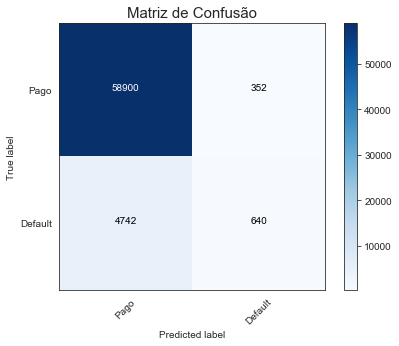

***********************
Curva Roc:
***********************
0.837


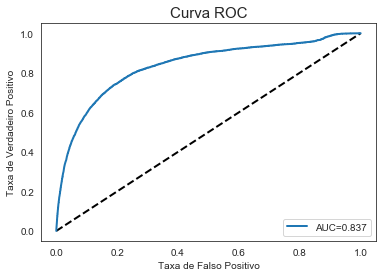

***********************
Curva Precision Recall:
***********************


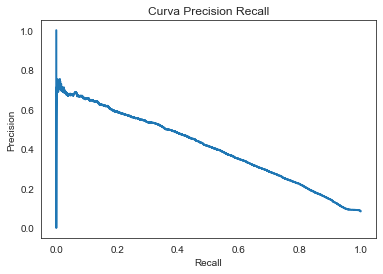

In [55]:
classes = ['Pago','Default']
y_pred = grid_RL.predict(x_teste)
y_scores_RL = grid_RL.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred, y_scores_RL, classes)

In [56]:
from sklearn.externals import joblib

# salva modelo Regressão Logística
joblib.dump(grid_RL.best_estimator_, 'Salvos/200830_grid_RL.pkl', compress = 1)

['Salvos/200830_grid_RL.pkl']

### RL: Com ao menos uma variável selecionada pelos métodos de seleção

In [57]:
%%time
from sklearn.linear_model import LogisticRegression
RL = LogisticRegression(random_state=42)

hyperparameters = {'penalty' : ['l1'], #['l1','l2'], 
                   'class_weight' : [None], #['balanced', None],
                   'C' : [100] #[0.001, 0.01, 0.1, 1, 10]
                  }

grid_RL_selected = GridSearchCV(RL, 
                  hyperparameters, 
                  cv=10,
                  verbose=0)
grid_RL_selected.fit(x_treino_selected, y_treino_selected)

# CENARIO 1
# 'C': 10, 'class_weight': None, 'penalty': 'l1'
# Accuracy  0.9255
# Precision  0.6241
# Recall  0.0538

# CENARIO 2
# 'C': 100
# Accuracy  0.9255
# Precision  0.6264
# Recall  0.0538

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Spe

CPU times: user 48.8 s, sys: 2.64 s, total: 51.5 s
Wall time: 1min 6s


GridSearchCV(cv=10, error_score='raise-deprecating',
             estimator=LogisticRegression(C=1.0, class_weight=None, dual=False,
                                          fit_intercept=True,
                                          intercept_scaling=1, l1_ratio=None,
                                          max_iter=100, multi_class='warn',
                                          n_jobs=None, penalty='l2',
                                          random_state=42, solver='warn',
                                          tol=0.0001, verbose=0,
                                          warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'C': [100], 'class_weight': [None], 'penalty': ['l1']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [58]:
grid_RL_selected.best_params_

{'C': 100, 'class_weight': None, 'penalty': 'l1'}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive     539
  True Negative   58925
 False Negative    4843
 False Positive     327
       Accuracy  0.9200
      Precision  0.6224
         Recall  0.1001
    Specificity  0.9945
       F1 Score  0.1725
  Roc Auc Score  0.8322
***********************
Confusion matrix, without normalization:


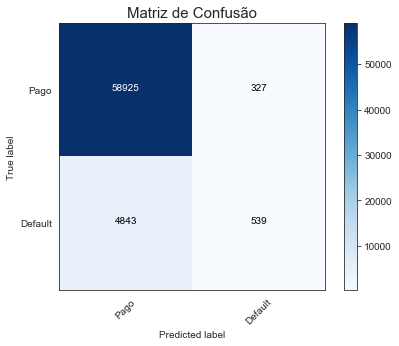

***********************
Curva Roc:
***********************
0.832


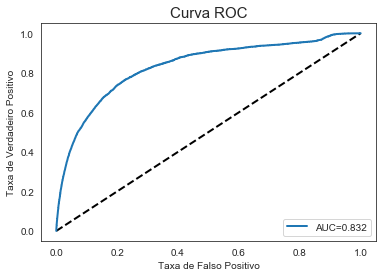

***********************
Curva Precision Recall:
***********************


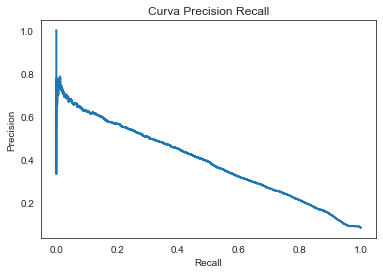

CPU times: user 999 ms, sys: 193 ms, total: 1.19 s
Wall time: 1.13 s


In [59]:
%%time
classes = ['Pago','Default']
y_pred_selected = grid_RL_selected.predict(x_teste_selected)
y_scores_RL_selected = grid_RL_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_selected, y_scores_RL_selected, classes)

In [60]:
from sklearn.externals import joblib

# salva modelo Regressão Logística com Seleção de Variáveis
joblib.dump(grid_RL_selected.best_estimator_, 'Salvos/200830_grid_RL_selected.pkl', compress = 1)

['Salvos/200830_grid_RL_selected.pkl']

### 6.1.2 Random Forest

### Random Forest: Todas as variáveis

Dicionário de hyperparâmetros para o **GridSearch** da Random Forest

In [61]:
%%time
from sklearn.ensemble import RandomForestClassifier

parametros_grid = {
    'n_estimators': [1000],
    'criterion':['gini'], #, 'entropy'],
    'max_features': ['auto'], #, 'sqrt', 'log2'],
    'bootstrap':[False],# [True, False],
    'min_samples_leaf': [1],
    'max_depth': [100],
    'min_samples_split': [2]
}

RF = RandomForestClassifier(random_state=123)


# CENARIO 1
# 'bootstrap': False,
# 'criterion': 'gini',
# 'max_features': 'auto',
# 'min_samples_leaf': 1,
# 'min_samples_split': 2,
# 'n_estimators': 100
# Accuracy  0.9489
# Precision  0.8746
# Recall  0.3835

# CENARIO 2
# 'n_estimators': [800]
# Accuracy  0.9496
# Precision  0.8828
# Recall  0.3908

# CENARIO 3 (34min)
# 'n_estimators': [1000]
# Accuracy  0.9496
# Precision  0.8834
# Recall  0.3904

CPU times: user 181 µs, sys: 2.6 ms, total: 2.78 ms
Wall time: 5.89 ms


In [63]:
%%time
from sklearn.model_selection import GridSearchCV

grid_RF = GridSearchCV(estimator=RF,
                    param_grid=parametros_grid,
                    scoring='accuracy',
                    cv=5)
grid_RF.fit(x_treino, y_treino)

CPU times: user 40min 59s, sys: 57.5 s, total: 41min 56s
Wall time: 49min 52s


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False, random_state=123,
                                              verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={

In [64]:
grid_RF.best_params_

{'bootstrap': False,
 'criterion': 'gini',
 'max_depth': 100,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 1000}

In [65]:
grid_RF.best_score_

0.9490421786209229

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    2657
  True Negative   58852
 False Negative    2725
 False Positive     400
       Accuracy  0.9517
      Precision  0.8692
         Recall  0.4937
    Specificity  0.9932
       F1 Score  0.6297
  Roc Auc Score  0.9584
***********************
Confusion matrix, without normalization:


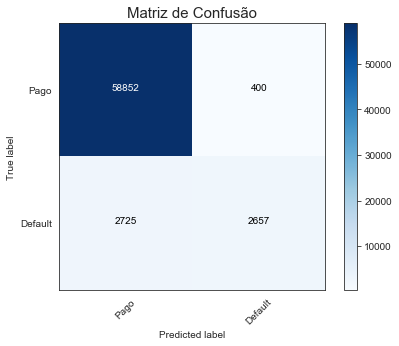

***********************
Curva Roc:
***********************
0.958


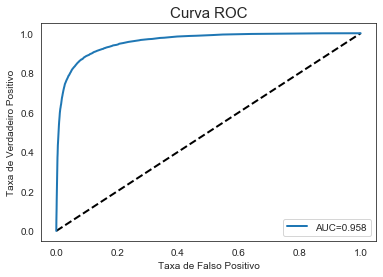

***********************
Curva Precision Recall:
***********************


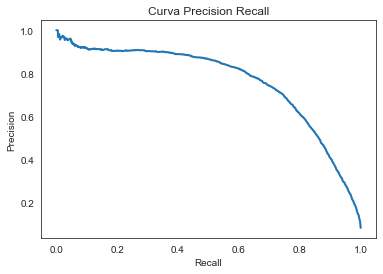

In [66]:
classes = ['Pago','Default']
y_pred = grid_RF.predict(x_teste)
y_scores_RF = grid_RF.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred, y_scores_RF, classes)

# ***********************
# Metrics Report:
# ***********************
# Classification Report:
# ***********************
#   True Positive    1242
#   True Negative   38417
#  False Negative    1939
#  False Positive     164
#        Accuracy  0.9496
#       Precision  0.8834
#          Recall  0.3904
#     Specificity  0.9957
#        F1 Score  0.5415
#   Roc Auc Score  0.9503
# ***********************

In [67]:
from sklearn.externals import joblib

# salva modelo Random Forest com todas as Variáveis
joblib.dump(grid_RF.best_estimator_, 'Salvos/200830_grid_RF.pkl', compress = 1)

['Salvos/200830_grid_RF.pkl']

### Random Forest: Com ao menos uma variável selecionada pelos métodos de seleção

In [68]:
%%time
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

parametros_grid = {
    'n_estimators': [600], #[400, 600],
    'criterion':['gini'], #, 'entropy'],
    'max_features': ['auto'], #, 'sqrt', 'log2'],
    'bootstrap': [False], #[True, False],
    'min_samples_leaf': [1],
    'max_depth': [100],#[10, 20, 100, None],
    'min_samples_split': [2] #[2,5,10]
}

RF_selected = RandomForestClassifier(random_state=123)

grid_RF_selected = GridSearchCV(estimator=RF_selected,
                    param_grid=parametros_grid,
                    scoring='recall',
                    cv=10)
grid_RF_selected.fit(x_treino_selected, y_treino_selected)

print(grid_RF_selected.best_params_)
RF_selected = RandomForestClassifier(**grid_RF_selected.best_params_, random_state=42)
RF_selected.fit(x_treino_selected, y_treino_selected)

# 29min

# CENARIO 1
# 'n_estimators': [100],
# 'criterion':['gini']
# 'max_features': ['auto']
# 'bootstrap': [False]
# 'min_samples_leaf': [1],
# 'max_depth': [100]
# 'min_samples_split': [2]
# Accuracy  0.9454
# Precision  0.8236
# Recall  0.3596

# CENARIO 2
# 'n_estimators': [400],
# Accuracy  0.9511
# Precision  0.8724
# Recall  0.4191

{'bootstrap': False, 'criterion': 'gini', 'max_depth': 100, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 600}
CPU times: user 34min 53s, sys: 42.7 s, total: 35min 36s
Wall time: 40min 46s


RandomForestClassifier(bootstrap=False, class_weight=None, criterion='gini',
                       max_depth=100, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=600,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    2800
  True Negative   58791
 False Negative    2582
 False Positive     461
       Accuracy  0.9529
      Precision  0.8586
         Recall  0.5203
    Specificity  0.9922
       F1 Score  0.6479
  Roc Auc Score  0.9631
***********************
Confusion matrix, without normalization:


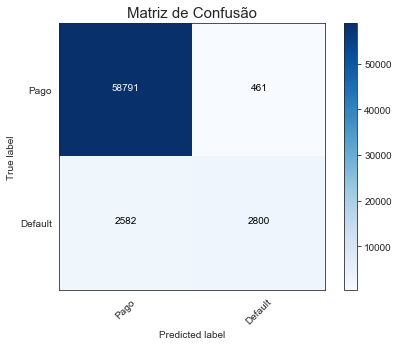

***********************
Curva Roc:
***********************
0.963


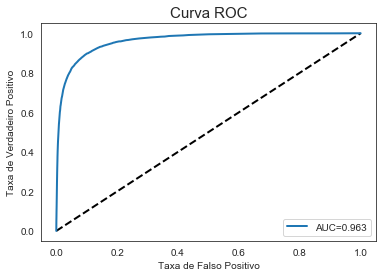

***********************
Curva Precision Recall:
***********************


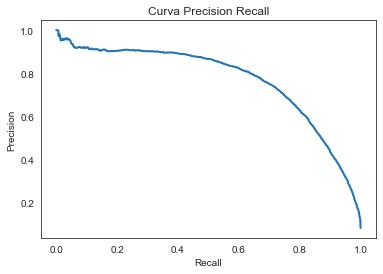

CPU times: user 20.6 s, sys: 5.44 s, total: 26.1 s
Wall time: 36.2 s


In [69]:
%%time
classes = ['Pago','Default']
y_pred_selected = grid_RF_selected.predict(x_teste_selected)
y_scores_RF_selected = grid_RF_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_selected, y_scores_RF_selected, classes)

# ***********************
# Metrics Report:
# ***********************
# Classification Report:
# ***********************
#   True Positive    1333
#   True Negative   38386
#  False Negative    1848
#  False Positive     195
#        Accuracy  0.9511
#       Precision  0.8724
#          Recall  0.4191
#     Specificity  0.9949
#        F1 Score  0.5661
#   Roc Auc Score  0.9521
# ***********************

In [70]:
from sklearn.externals import joblib

# salva modelo Random Forest com Seleção de Variáveis
joblib.dump(grid_RF_selected.best_estimator_, 'Salvos/200830_grid_RF_selected.pkl', compress = 1)

['Salvos/200830_grid_RF_selected.pkl']

### 6.1.4 Soft Voting Classifier: Combina 2 classificadores em 1

In [71]:
%%time
classes = ['Pago','Default']
voting_clf = VotingClassifier (
        estimators = [('lg', grid_RL_selected), ('rf', grid_RF_selected)], voting='soft')

voting_clf.fit(x_treino_selected, y_treino_selected)

y_pred = voting_clf.predict(x_teste_selected)
y_scores_VotingClassifier = voting_clf.predict_proba(x_teste_selected)[:,1]

# 28min

# ***********************
# Metrics Report:
# ***********************
# Classification Report:
# ***********************
#   True Positive     587
#   True Negative   38495
#  False Negative    2594
#  False Positive      86
#        Accuracy  0.9358
#       Precision  0.8722
#          Recall  0.1845
#     Specificity  0.9978
#        F1 Score  0.3046
#   Roc Auc Score  0.9296
# ***********************

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Spe

CPU times: user 32min 20s, sys: 41.7 s, total: 33min 2s
Wall time: 35min 44s


***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    1597
  True Negative   58983
 False Negative    3785
 False Positive     269
       Accuracy  0.9373
      Precision  0.8558
         Recall  0.2967
    Specificity  0.9955
       F1 Score  0.4407
  Roc Auc Score  0.9395
***********************
Confusion matrix, without normalization:


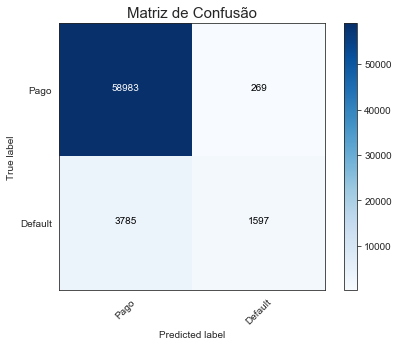

***********************
Curva Roc:
***********************
0.939


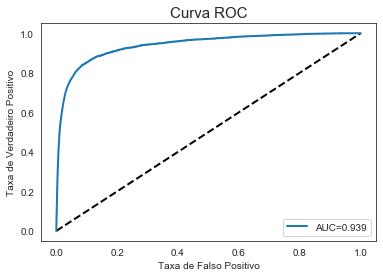

***********************
Curva Precision Recall:
***********************


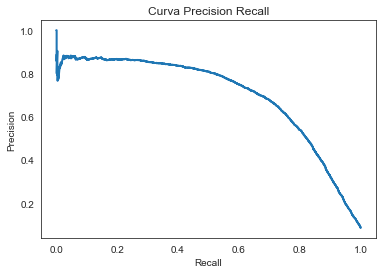

In [72]:
HelperClass.show_full_classification_report(y_teste_selected, y_pred, y_scores_VotingClassifier, classes)

In [73]:
from sklearn.externals import joblib

# salva modelo Soft Voting Classifier com Seleção de Variáveis
joblib.dump(voting_clf, 'Salvos/200830_voting_clf.pkl', compress = 1)

['Salvos/200830_voting_clf.pkl']

### Recupera Modelos Salvos
(adicionado depois para não ter que rodar os modelos novamente)

Recupera bases salvas<br>
Salvei o dataframe com as variáveis selecionadas (explicativas_selected) e também quais as variáveis que foram selecionadas (var_select_selected)<br>
Target é a lista com a variável alvo

In [49]:
explicativas_selected =  pd.read_parquet(path+'/200830_explicativas_selected.parquet.gzip')
explicativas =  pd.read_parquet(path+'/200830_explicativas.parquet.gzip')
aux =  pd.read_parquet(path+'/200830_var_select_selected.parquet.gzip')
var_select_selected = aux['var_select_selected'].tolist()
target = pd.read_csv(path+"/200830_target.csv")
target = target.set_index('Unnamed: 0')

x_treino, x_teste, y_treino, y_teste = train_test_split(explicativas,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

x_treino_selected, x_teste_selected, y_treino_selected, y_teste_selected = train_test_split(explicativas_selected,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)


# Regressão Logística sem feature selection
modelo_treinado_RL = open('Salvos/200830_grid_RL.pkl', 'rb')
grid_RL = joblib.load(modelo_treinado_RL)

# Regressão Logística sem feature selection
modelo_treinado_RL_selected = open('Salvos/200830_grid_RL_selected.pkl', 'rb')
grid_RL_selected = joblib.load(modelo_treinado_RL_selected)

# Random Forest sem feature selection
modelo_treinado_RF = open('Salvos/200830_grid_RF.pkl', 'rb')
grid_RF = joblib.load(modelo_treinado_RF)

# Random Forest sem feature selection
modelo_treinado_RF_selected = open('Salvos/200830_grid_RF_selected.pkl', 'rb')
grid_RF_selected = joblib.load(modelo_treinado_RF_selected)

### Comparando Algoritmos Estatística Tradicional

Curva ROC - Entrega 2 (slide Regressão Logistica)

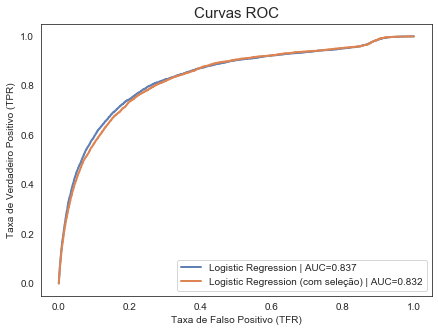

In [75]:
plt.figure(figsize=(7,5))

# Logistic Regression sem seleção de variáveis
y_scores_RL = grid_RL.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RL)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RL))
plt.plot(fpr, tpr, label = 'Logistic Regression | AUC='+str(auc), linewidth = 2 ,color='#6180B4')

# Logistic Regression com seleção de variáveis 
y_scores_RL_selected = grid_RL_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RL_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RL_selected))
plt.plot(fpr, tpr, label = 'Logistic Regression (com seleção) | AUC='+str(auc), linewidth = 2, color='#DD8452')

plt.title('Curvas ROC', fontsize=15)
plt.xlabel('Taxa de Falso Positivo (TFR)')
plt.ylabel('Taxa de Verdadeiro Positivo (TPR)')
plt.legend(loc=0)

plt.savefig("Slides/roc_logistic_regression.png", dpi=100, bbox_inches='tight')

Curva ROC - Entrega 2 (slide Random Forest)

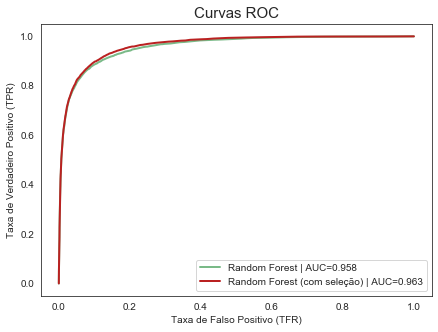

In [76]:
plt.figure(figsize=(7,5))

# Random Forest sem seleção de variáveis
y_scores_RF = grid_RF.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RF)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RF))
plt.plot(fpr, tpr, label = 'Random Forest | AUC='+str(auc), linewidth = 2, color='#7ABA88')

# Random Forest com seleção de variáveis
y_scores_RF_selected = grid_RF_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RF_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RF_selected))
plt.plot(fpr, tpr, label = 'Random Forest (com seleção) | AUC='+str(auc), linewidth = 2, color='#BA2121')

plt.title('Curvas ROC', fontsize=15)
plt.xlabel('Taxa de Falso Positivo (TFR)')
plt.ylabel('Taxa de Verdadeiro Positivo (TPR)')
plt.legend(loc=0)
# plt.show()
plt.savefig("Slides/roc_random_forest.png", dpi=100, bbox_inches='tight')

Curva ROC: Regressão Logística e Random Forest. Com e sem Feature Selection

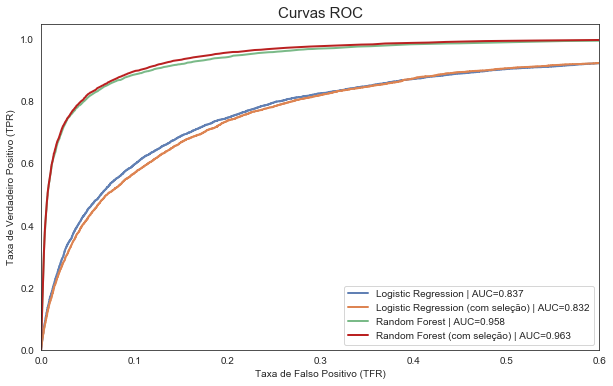

In [42]:
plt.figure(figsize=(10,6))

# Logistic Regression sem seleção de variáveis
y_scores_RL = grid_RL.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RL)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RL))
plt.plot(fpr, tpr, label = 'Logistic Regression | AUC='+str(auc), linewidth = 2 ,color='#6180B4')

# Logistic Regression com seleção de variáveis
y_scores_RL_selected = grid_RL_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RL_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RL_selected))
plt.plot(fpr, tpr, label = 'Logistic Regression (com seleção) | AUC='+str(auc), linewidth = 2, color='#DD8452')

# Random Forest sem seleção de variáveis
y_scores_RF = grid_RF.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RF)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RF))
plt.plot(fpr, tpr, label = 'Random Forest | AUC='+str(auc), linewidth = 2, color='#7ABA88')

# Random Forest com seleção de variáveis
y_scores_RF_selected = grid_RF_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RF_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RF_selected))
plt.plot(fpr, tpr, label = 'Random Forest (com seleção) | AUC='+str(auc), linewidth = 2, color='#BA2121')

# Softing Vote
# y_scores_VotingClassifier = voting_clf.predict_proba(x_teste_selected)[:,1]
# fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_VotingClassifier)
# auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_VotingClassifier))
# plt.plot(fpr, tpr, label = 'Soft Voting Classifier | AUC='+str(auc), linewidth = 2)

plt.title('Curvas ROC', fontsize=15)
plt.xlim([0.0, 0.6])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falso Positivo (TFR)')
plt.ylabel('Taxa de Verdadeiro Positivo (TPR)')
plt.legend(loc=0)
plt.savefig("Slides/roc_LR_and_RF.png", dpi=100, bbox_inches='tight')

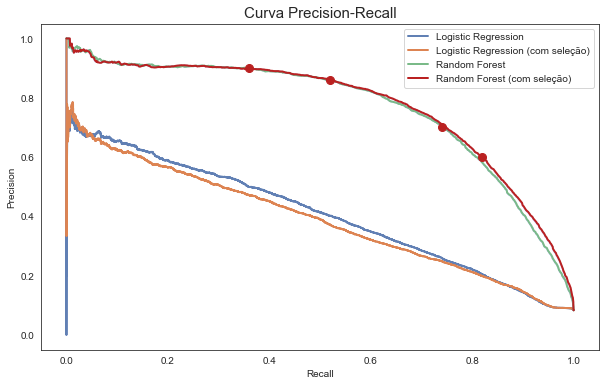

In [53]:
plt.figure(figsize=(10,6))
precision, recall, thresholds = precision_recall_curve(y_teste, y_scores_RL)
plt.step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
plt.plot(recall, precision, label = 'Logistic Regression', linewidth=2, color='#6180B4')

precision, recall, thresholds = precision_recall_curve(y_teste_selected, y_scores_RL_selected)
plt.step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
plt.plot(recall, precision, label = 'Logistic Regression (com seleção)', linewidth=2, color='#DD8452')

precision, recall, thresholds = precision_recall_curve(y_teste, y_scores_RF)
plt.step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
plt.plot(recall, precision, label = 'Random Forest', linewidth=2, color='#7ABA88')

precision, recall, thresholds = precision_recall_curve(y_teste_selected, y_scores_RF_selected)
plt.step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
plt.plot(recall, precision, label = 'Random Forest (com seleção)', linewidth=2, color='#BA2121')
plt.plot([0.82], [0.60], 'o', color='#BA2121', markersize=8)
plt.plot([0.74], [0.70], 'o', color='#BA2121', markersize=8)
plt.plot([0.36], [0.90], 'o', color='#BA2121', markersize=8)
plt.plot([0.52], [0.86], 'o', color='#BA2121', markersize=8)

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Curva Precision-Recall', fontsize=15)
plt.legend(loc=0)

plt.savefig("Slides/precision_recall_LR_and_RF.png", dpi=100, bbox_inches='tight')

In [43]:
precision, recall, thresholds = precision_recall_curve(y_teste_selected, y_scores_RF_selected)

In [44]:
precision = list(reversed(precision))
recall = list(reversed(recall))
thresholds = list(reversed(thresholds))

df = pd.DataFrame(list(zip(precision, recall, thresholds)), 
               columns =['precision', 'recall', 'thresholds'])
df = df.drop_duplicates()

In [45]:
df[(df['thresholds'] == 0.5)].head(10)

,precision,recall,thresholds
300,0.86,0.52,0.50


In [51]:
df[(df['precision'] >= 0.8) & (df['precision'] <= 0.9)].head(10)

,precision,recall,thresholds
201,0.90,0.34,0.67
203,0.90,0.34,0.66
204,0.90,0.34,0.66
205,0.90,0.34,0.66
206,0.90,0.35,0.66
207,0.90,0.35,0.66
208,0.90,0.35,0.65
209,0.90,0.35,0.65
210,0.90,0.35,0.65
211,0.90,0.36,0.65


In [47]:
df[(df['precision'] >= 0.7) & (df['precision'] <= 0.71)].head(10)

,precision,recall,thresholds
429,0.71,0.74,0.28
430,0.71,0.74,0.28
431,0.71,0.74,0.28
432,0.71,0.75,0.28
433,0.70,0.75,0.28
434,0.70,0.75,0.28


In [48]:
df[(df['precision'] >= 0.6) & (df['precision'] <= 0.62)].head(10)

,precision,recall,thresholds
471,0.62,0.80,0.21
472,0.62,0.81,0.21
473,0.62,0.81,0.21
474,0.61,0.81,0.21
475,0.61,0.81,0.21
476,0.61,0.81,0.21
477,0.61,0.82,0.20
478,0.60,0.82,0.20


In [49]:
df[(df['thresholds'] < 0.5) & (df['recall'] > 0.65) & (df['precision'] > 0.65)].head(10)

,precision,recall,thresholds
376,0.79,0.65,0.37
377,0.79,0.65,0.37
378,0.79,0.65,0.37
379,0.79,0.66,0.37
380,0.79,0.66,0.37
381,0.79,0.66,0.36
382,0.79,0.66,0.36
383,0.78,0.66,0.36
384,0.78,0.66,0.36
385,0.78,0.66,0.36


## Recuperando Modelos Salvos

In [42]:
explicativas_selected =  pd.read_parquet(path+'/200830_explicativas_selected.parquet.gzip')
explicativas =  pd.read_parquet(path+'/200830_explicativas.parquet.gzip')
aux =  pd.read_parquet(path+'/200830_var_select_selected.parquet.gzip')
var_select_selected = aux['var_select_selected'].tolist()
target = pd.read_csv(path+"/200830_target.csv")
target = target.set_index('Unnamed: 0')

explicativas_selected = explicativas[var_select_selected]

x_treino, x_teste, y_treino, y_teste = train_test_split(explicativas,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

x_treino_selected, x_teste_selected, y_treino_selected, y_teste_selected = train_test_split(explicativas_selected,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

Regressão Logística com todas as variáveis:

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive     640
  True Negative   58900
 False Negative    4742
 False Positive     352
       Accuracy  0.9212
      Precision  0.6452
         Recall  0.1189
    Specificity  0.9941
       F1 Score  0.2008
  Roc Auc Score  0.8367
***********************
Confusion matrix, without normalization:


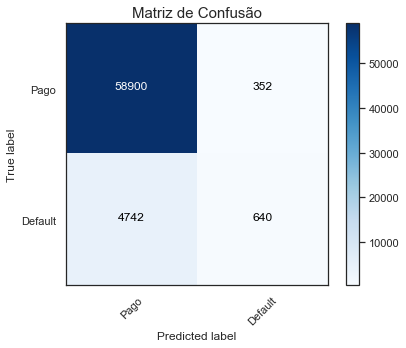

***********************
Curva Roc:
***********************
0.837


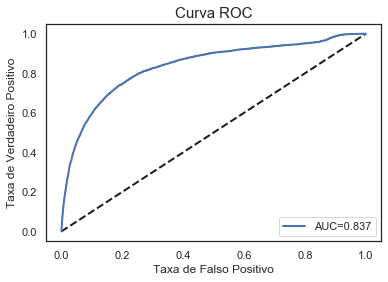

***********************
Curva Precision Recall:
***********************


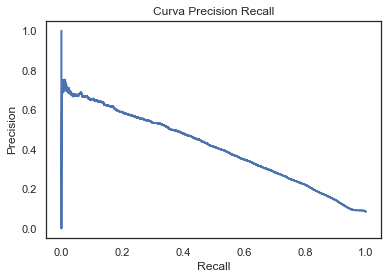

In [43]:
modelo_treinado_RL = open('Salvos/200830_grid_RL.pkl', 'rb')
model_RL = joblib.load(modelo_treinado_RL)
classes = ['Pago','Default']
y_pred_lido = model_RL.predict(x_teste)
y_scores_RL_lido = model_RL.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred_lido, y_scores_RL_lido, classes)

Regressão Logística com todas as variáveis: Feature Importance

In [80]:
coefs = np.abs(model_RL.coef_[0])
indices = np.argsort(coefs)[::-1]
importances = coefs[indices[:]]
variables = explicativas.columns[indices[:]]

base_imp_RL_allvariables = imp_df(variables, importances)
base_imp_RL_allvariables.head(10)

,feature,feature_importance
0,fklearn_feat__subpgmdesc==Small Asset Based,7.04
1,fklearn_feat__BorrState==FM,5.96
2,fklearn_feat__BorrState==MP,5.87
3,fklearn_feat__BorrState==MH,4.36
4,fklearn_feat__subpgmdesc==EXPORT IMPORT HARMON...,4.08
5,fklearn_feat__subpgmdesc==Small General Contra...,3.79
6,fklearn_feat__DeliveryMethod==EWCP,3.36
7,fklearn_feat__subpgmdesc==Revolving Line of Cr...,3.05
8,fklearn_feat__BankState==WV,3.05
9,fklearn_feat__subpgmdesc==Contract Guaranty,2.89


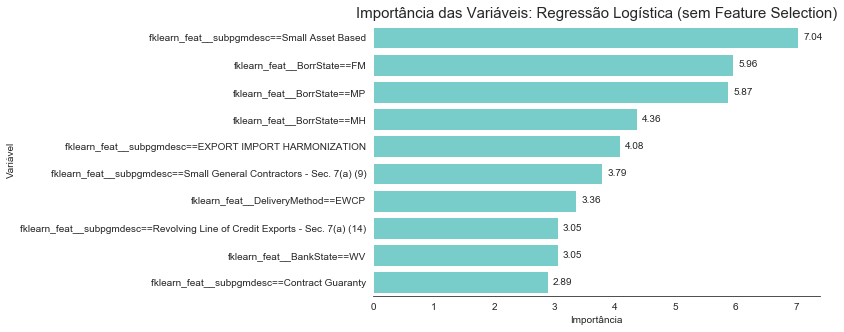

In [81]:
ax = var_imp_plot(base_imp_RL_allvariables.head(10), xlabel='Importância', ylabel='Variável',
                  annotation = True, title='Importância das Variáveis: Regressão Logística (sem Feature Selection)', figsize=(8, 5))

In [82]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RL.png", dpi=80, bbox_inches='tight')

Regressão Logística com seleção de variáveis:

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive     539
  True Negative   58925
 False Negative    4843
 False Positive     327
       Accuracy  0.9200
      Precision  0.6224
         Recall  0.1001
    Specificity  0.9945
       F1 Score  0.1725
  Roc Auc Score  0.8322
***********************
Confusion matrix, without normalization:


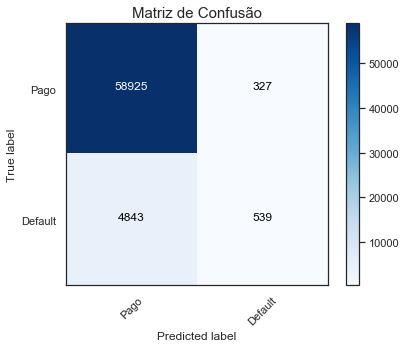

***********************
Curva Roc:
***********************
0.832


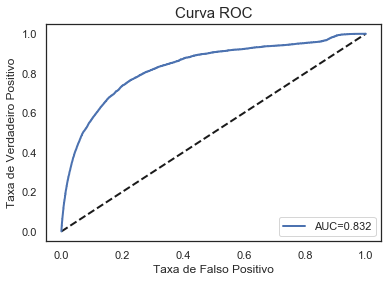

***********************
Curva Precision Recall:
***********************


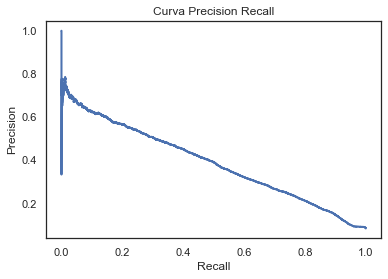

In [45]:
modelo_treinado_RL_selected = open('Salvos/200830_grid_RL_selected.pkl', 'rb')
model_RL_selected = joblib.load(modelo_treinado_RL_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_RL_selected.predict(x_teste_selected)
y_scores_RL_lido_selected = model_RL_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_lido_selected, y_scores_RL_lido_selected, classes)

Regressão Logística com seleção de variaveis: Feature Importance

In [46]:
coefs = np.abs(model_RL_selected.coef_[0])
indices = np.argsort(coefs)[::-1]
importances = coefs[indices[:]]
variables = explicativas_selected.columns[indices[:]]

base_imp_RL_selected = imp_df(variables, importances)
base_imp_RL_selected.head(10)

,feature,feature_importance
0,fklearn_feat__DeliveryMethod==EWCP,3.42
1,fklearn_feat__subpgmdesc==Revolving Line of Cr...,2.16
2,fklearn_feat__subpgmdesc==Guaranty,2.04
3,fklearn_feat__DeliveryMethod==PLP,1.44
4,fklearn_feat__subpgmdesc==Community Express,1.20
5,shareSBAGuaranteedTotalApproval,1.13
6,fklearn_feat__DeliveryMethod==OTH 7A,1.09
7,fklearn_feat__NaicsSectorDescription==Accommod...,1.09
8,fklearn_feat__BankState==ME,1.01
9,fklearn_feat__BankState==HI,0.96


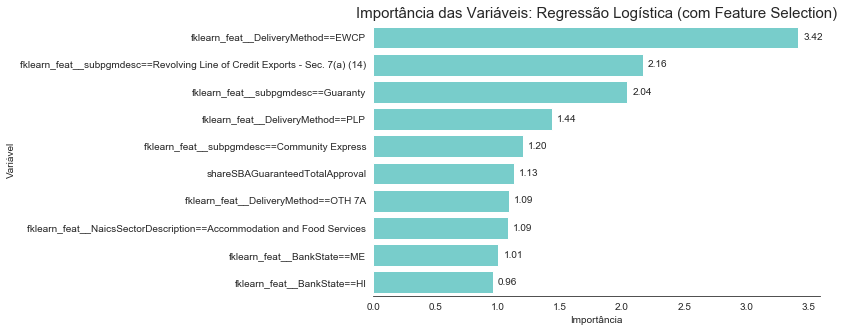

In [85]:
ax = var_imp_plot(base_imp_RL_selected.head(10), xlabel='Importância', ylabel='Variável', 
                  annotation = True, title='Importância das Variáveis: Regressão Logística (com Feature Selection)', figsize=(8, 5))

In [188]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RL_selected.png", dpi=80, bbox_inches='tight')

Random Forest com todas as variáveis:

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    2657
  True Negative   58852
 False Negative    2725
 False Positive     400
       Accuracy  0.9517
      Precision  0.8692
         Recall  0.4937
    Specificity  0.9932
       F1 Score  0.6297
  Roc Auc Score  0.9584
***********************
Confusion matrix, without normalization:


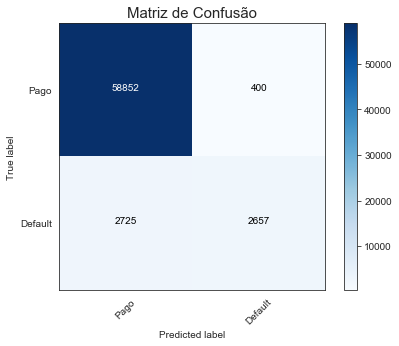

***********************
Curva Roc:
***********************
0.958


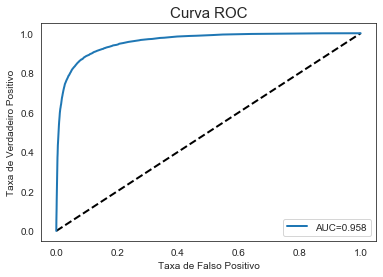

***********************
Curva Precision Recall:
***********************


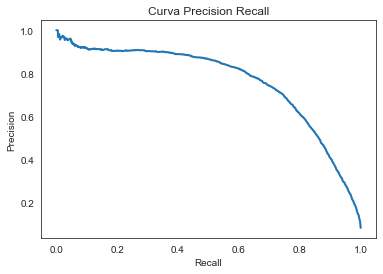

In [86]:
modelo_treinado_RF = open('Salvos/200830_grid_RF.pkl', 'rb')
model_RF = joblib.load(modelo_treinado_RF)
classes = ['Pago','Default']
y_pred_lido = model_RF.predict(x_teste)
y_scores_RF_lido = model_RF.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred_lido, y_scores_RF_lido, classes)

Random Forest com todas as variáveis: Feature Importance

In [87]:
base_imp = imp_df(x_teste.columns, model_RF.feature_importances_)
base_imp.head(10)

,feature,feature_importance
0,TermInMonths,0.31
1,InitialInterestRate,0.08
2,SBAGuaranteedApproval,0.06
3,GrossApproval,0.06
4,JobsSupported,0.06
5,daysFromApprovalToFirstDisbursement,0.05
6,SBADistrictOffice,0.04
7,RevolverStatus,0.02
8,fklearn_feat__BankState==OH,0.02
9,shareSBAGuaranteedTotalApproval,0.01


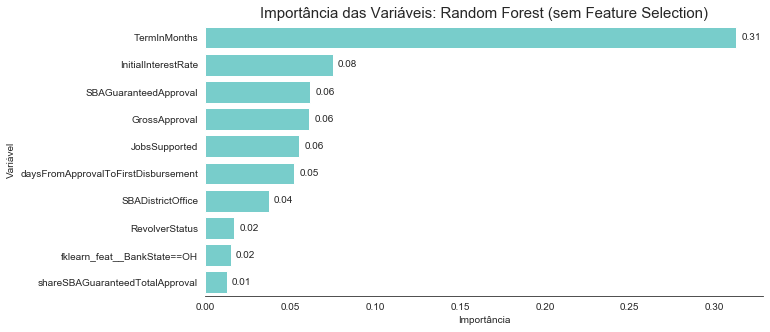

In [88]:
ax = var_imp_plot(base_imp.head(10), xlabel='Importância', ylabel='Variável', 
                  annotation = True, title='Importância das Variáveis: Random Forest (sem Feature Selection)', figsize=(10, 5))

In [89]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RF.png", dpi=80, bbox_inches='tight')

Random Forest com todas as variáveis: Feature Importance com Permutation

In [90]:
# Permutation feature importance
# Reference: https://github.com/erykml/medium_articles/blob/master/Machine%20Learning/feature_importance.ipynb
from sklearn.metrics import r2_score
from rfpimp import permutation_importances

def r2(rf, X_train, y_train):
    return r2_score(y_train, rf.predict(X_train))

perm_imp_rfpimp = permutation_importances(model_RF, x_treino, y_treino, r2)
perm_imp_rfpimp.reset_index(drop = False, inplace = True)
perm_imp_rfpimp = perm_imp_rfpimp.rename(columns={'Feature': 'feature', 'Importance': 'feature_importance'})

In [91]:
perm_imp_rfpimp.to_csv('Salvos/perm_imp_rfpimp.csv',index = False, header=True)

In [92]:
perm_imp_rfpimp = pd.read_csv('Salvos/perm_imp_rfpimp.csv')

In [93]:
perm_imp_rfpimp.head(10)

,feature,feature_importance
0,TermInMonths,1.36
1,InitialInterestRate,0.28
2,SBAGuaranteedApproval,0.06
3,RevolverStatus,0.06
4,fklearn_feat__BankState==OH,0.05
5,shareSBAGuaranteedTotalApproval,0.05
6,GrossApproval,0.05
7,daysFromApprovalToFirstDisbursement,0.04
8,JobsSupported,0.03
9,sameStateLoan,0.03


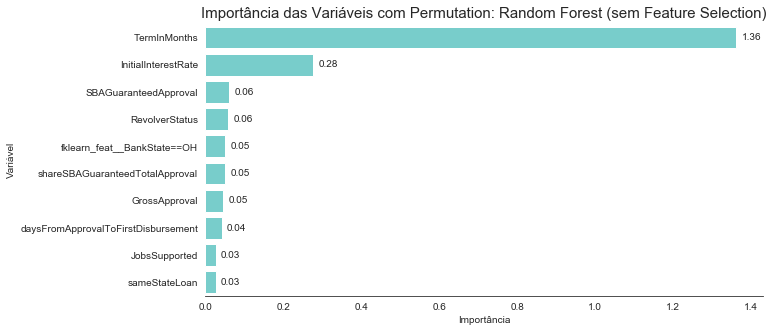

In [94]:
ax = var_imp_plot(perm_imp_rfpimp.head(10), xlabel='Importância', ylabel='Variável', 
                  annotation = True, title='Importância das Variáveis com Permutation: Random Forest (sem Feature Selection)', figsize=(10, 5))
# var_imp_plot(perm_imp_rfpimp.head(10), 'Permutation feature importance (rfpimp)')

In [95]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RL_with_permutation.png", dpi=80, bbox_inches='tight')

Random Forest com seleção de variáveis: Feature Importance

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    2800
  True Negative   58791
 False Negative    2582
 False Positive     461
       Accuracy  0.9529
      Precision  0.8586
         Recall  0.5203
    Specificity  0.9922
       F1 Score  0.6479
  Roc Auc Score  0.9631
***********************
Confusion matrix, without normalization:


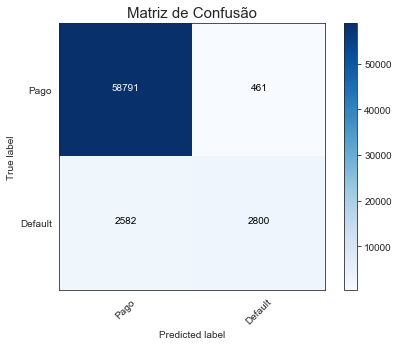

***********************
Curva Roc:
***********************
0.963


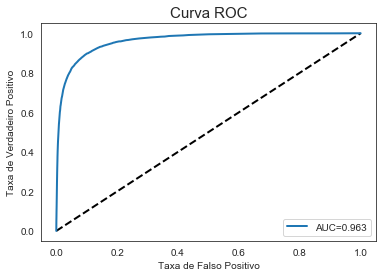

***********************
Curva Precision Recall:
***********************


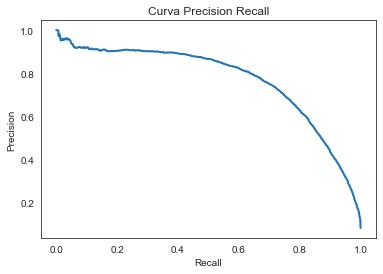

In [96]:
modelo_treinado_RF_selected = open('Salvos/200830_grid_RF_selected.pkl', 'rb')
model_RF_selected = joblib.load(modelo_treinado_RF_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_RF_selected.predict(x_teste_selected)
y_scores_RF_lido_selected = model_RF_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_lido_selected, y_scores_RF_lido_selected, classes)

In [97]:
# List the importance of each feature
base_imp = imp_df(x_teste_selected.columns, model_RF_selected.feature_importances_)
base_imp.head(10)

,feature,feature_importance
0,TermInMonths,0.34
1,InitialInterestRate,0.08
2,SBAGuaranteedApproval,0.07
3,GrossApproval,0.06
4,JobsSupported,0.06
5,daysFromApprovalToFirstDisbursement,0.05
6,SBADistrictOffice,0.05
7,RevolverStatus,0.02
8,fklearn_feat__BankState==OH,0.02
9,sameStateLoan,0.01


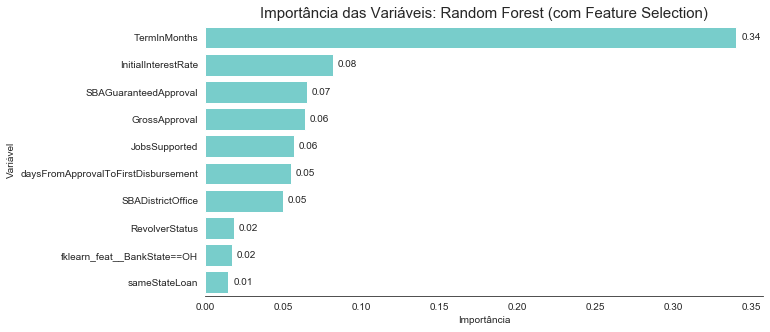

In [98]:
ax = var_imp_plot(base_imp.head(10), xlabel='Importância', ylabel='Variável', 
                  annotation = True, title='Importância das Variáveis: Random Forest (com Feature Selection)', figsize=(10, 5))

In [99]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RL_selected.png", dpi=80, bbox_inches='tight')

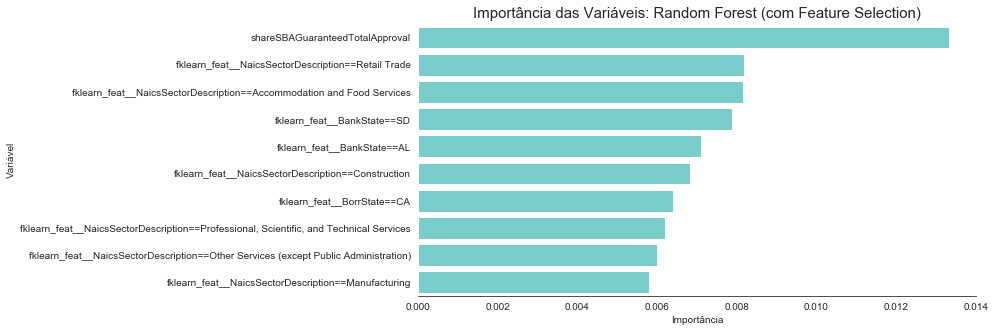

In [100]:
ax = var_imp_plot(base_imp[10:20], xlabel='Importância', ylabel='Variável', 
                  annotation = False, title='Importância das Variáveis: Random Forest (com Feature Selection)', figsize=(10, 5))

In [101]:
# Permutation feature importance
# Reference: https://github.com/erykml/medium_articles/blob/master/Machine%20Learning/feature_importance.ipynb
from sklearn.metrics import r2_score
from rfpimp import permutation_importances

def r2(rf, X_train, y_train):
    return r2_score(y_train, rf.predict(X_train))

perm_imp_rfpimp_selected = permutation_importances(model_RF_selected, x_treino_selected, y_treino_selected, r2)
perm_imp_rfpimp_selected.reset_index(drop = False, inplace = True)
perm_imp_rfpimp_selected = perm_imp_rfpimp_selected.rename(columns={'Feature': 'feature', 'Importance': 'feature_importance'})

In [102]:
perm_imp_rfpimp_selected.to_csv('perm_imp_rfpimp_selected.csv')

In [103]:
perm_imp_rfpimp_selected = pd.read_csv('perm_imp_rfpimp_selected.csv')
perm_imp_rfpimp_selected.head(10)

,Unnamed: 0,feature,feature_importance
0,0,TermInMonths,1.52
1,1,InitialInterestRate,0.38
2,2,sameStateLoan,0.11
3,3,GrossApproval,0.09
4,4,RevolverStatus,0.09
5,5,shareSBAGuaranteedTotalApproval,0.09
6,6,daysFromApprovalToFirstDisbursement,0.07
7,7,SBAGuaranteedApproval,0.07
8,8,SBADistrictOffice,0.03
9,9,fklearn_feat__BankState==OH,0.03


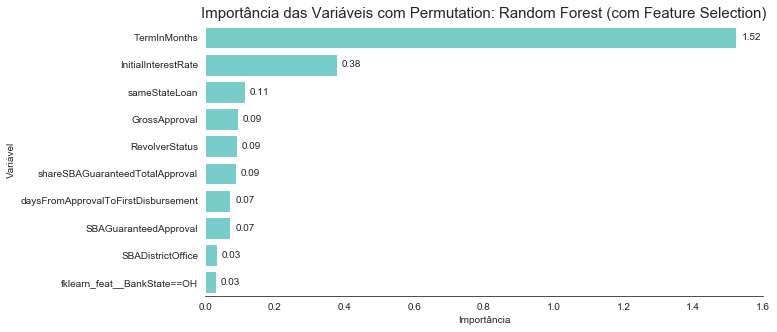

In [104]:
ax = var_imp_plot(perm_imp_rfpimp_selected.head(10), xlabel='Importância', ylabel='Variável', 
                  annotation = True, title='Importância das Variáveis com Permutation: Random Forest (com Feature Selection)', figsize=(10, 5))
# var_imp_plot(perm_imp_rfpimp.head(10), 'Permutation feature importance (rfpimp)')

In [105]:
fig = ax.get_figure()
fig.savefig("Slides/feature_importance_RF_selected_with_permutation.png", dpi=80, bbox_inches='tight')

Abaixo temos os resultados do **Soft Voting Classifier** que combinou os modelos de Regressão Logística (RL) e Random Forest (RF). Optei por não inserir na apresentação pois ele mostrou resultados intermediários entre os dois modelos, como esperado. Deixo registrado os resultados para efeitos comparativos.

**Como funciona o soft voting?** A classe de predição final é baseada na média calculada da probabilidade usando todas as predições dos modelos base. Por exemplo, se o modelo de RL prevê uma classe positiva com 70% de probabilidade e o modelo de RF prevê com 90%, então o Voting irá calcular como 80% a probabilidade da observação ser da classe positiva.

Referência: https://levelup.gitconnected.com/ensemble-learning-using-the-voting-classifier-a28d450be64d

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    1597
  True Negative   58983
 False Negative    3785
 False Positive     269
       Accuracy  0.9373
      Precision  0.8558
         Recall  0.2967
    Specificity  0.9955
       F1 Score  0.4407
  Roc Auc Score  0.9395
***********************
Confusion matrix, without normalization:


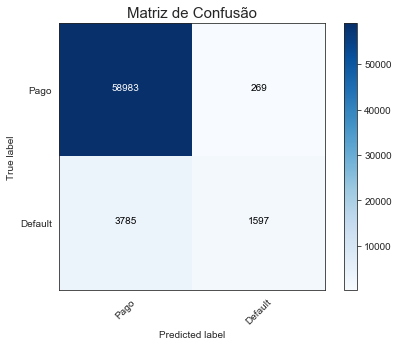

***********************
Curva Roc:
***********************
0.939


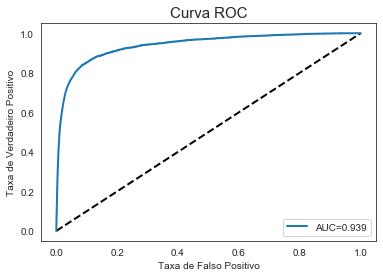

***********************
Curva Precision Recall:
***********************


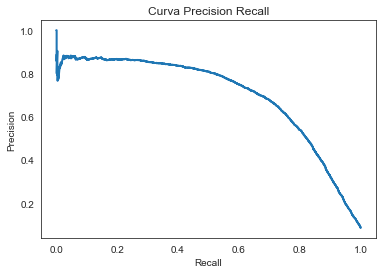

In [106]:
# Soft Vote Classifier
modelo_treinado_voting_clf = open('Salvos/200830_voting_clf.pkl', 'rb')
model_RL_voting_clf = joblib.load(modelo_treinado_voting_clf)
classes = ['Pago','Default']
y_pred_lido_voting_clf = model_RL_voting_clf.predict(x_teste_selected)
y_scores_RL_lido_voting_clf = model_RL_voting_clf.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_lido_voting_clf, y_scores_RL_lido_voting_clf, classes)

### Impacto Negócio
Baseado no melhor modelo qual o impacto para o negócio?

In [50]:
### Random Forest com todas as variaveis
y_scores_RF_selected = grid_RF_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RF_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RF_selected))

In [54]:
df_RF_selected = metricsByThresholdRange(x_teste_selected, y_teste_selected, y_scores_RF_selected,0.0,1.0,0.01)

In [121]:
df_RF_selected['share_sba_gross_loss'] = 100*df_RF_selected['sba_gross_loss'] / df_RF_selected['SBAGuaranteedApproval']
df_RF_selected['share_opportunity_loss'] = 100*df_RF_selected['opportunity_loss'] / df_RF_selected['GrossApproval']

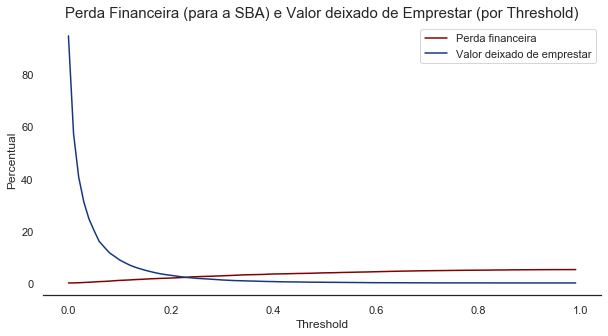

In [122]:
plt.figure(figsize=(10, 5))
ax = sns.lineplot(x='threshold', y='share_sba_gross_loss', data=df_RF_selected, color='#830000')
ax = sns.lineplot(x='threshold', y='share_opportunity_loss', data=df_RF_selected, color='#163780')
ax.axes.set_title("Perda Financeira (para a SBA) e Valor deixado de Emprestar (por Threshold)",fontsize=15)
ax.legend(['Perda financeira', 'Valor deixado de emprestar'])
# ylabels = ['{:,.0f}'.format(y) + 'B' for y in ax.get_yticks()/1000000000]
# ax.set_yticklabels(ylabels)
ax.set(xlabel="Threshold", ylabel="Opportunity Loss")
ax.set_ylabel(ylabel="Percentual",fontsize=12)
sns.set_style("white")
sns.despine(left=True)

In [120]:
df_RF_selected.iloc[50:51]

,threshold,GrossApproval,SBAGuaranteedApproval,Target,scores,Predicted,TP,TN,FP,FN,gross_loss,opportunity_loss,sba_gross_loss,sba_opportunity_loss,accuracy,precision,recall,sensitivity,specificity,f1_score,share_sba_gross_loss,share_opportunity_loss
50,0.50,20373505200.00,15189099072.00,5382.00,5482.39,3261.00,2800.00,58791.00,461.00,2582.00,767567670.00,51759200.00,589423904.00,37725550.00,0.95,0.86,0.52,0.52,0.99,0.65,0.04,0.00


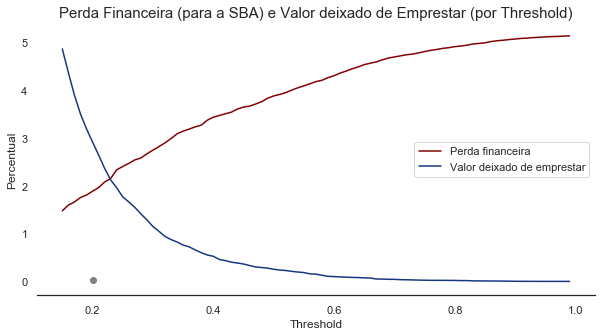

In [126]:
plt.figure(figsize=(10, 5))
df_RF_selected_filtered = df_RF_selected[15:]
ax = sns.lineplot(x='threshold', y='share_sba_gross_loss', data=df_RF_selected_filtered, color='#830000')
ax = sns.lineplot(x='threshold', y='share_opportunity_loss', data=df_RF_selected_filtered, color='#163780')
ax.axes.set_title("Perda Financeira (para a SBA) e Valor deixado de Emprestar (por Threshold)",fontsize=15)
ax.legend(['Perda financeira', 'Valor deixado de emprestar'])
ylabels = ['{:,.0f}'.format(y) for y in ax.get_yticks()]
ax.set_yticklabels(ylabels)
ax.set(xlabel="Threshold", ylabel="Opportunity Loss")
plt.scatter(0.2, 0.03, color='gray')
ax.set_ylabel(ylabel="Percentual",fontsize=12)
sns.set_style("white")
sns.despine(left=True)

In [129]:
df_RF_selected.iloc[50].sba_gross_loss

threshold                          0.50
GrossApproval            20373505200.00
SBAGuaranteedApproval    15189099072.00
Target                          5382.00
scores                          5482.39
Predicted                       3261.00
TP                              2800.00
TN                             58791.00
FP                               461.00
FN                              2582.00
gross_loss                 767567670.00
opportunity_loss            51759200.00
sba_gross_loss             589423904.00
sba_opportunity_loss        37725550.00
accuracy                           0.95
precision                          0.86
recall                             0.52
sensitivity                        0.52
specificity                        0.99
f1_score                           0.65
share_sba_gross_loss               3.88
share_opportunity_loss             0.25
Name: 50, dtype: float64

In [132]:
df_RF_selected[df_RF_selected.index.isin([20,28,50,65])]

,threshold,GrossApproval,SBAGuaranteedApproval,Target,scores,Predicted,TP,TN,FP,FN,gross_loss,opportunity_loss,sba_gross_loss,sba_opportunity_loss,accuracy,precision,recall,sensitivity,specificity,f1_score,share_sba_gross_loss,share_opportunity_loss
20,0.20,20373505200.00,15189099072.00,5382.00,5482.39,7406.00,4424.00,56270.00,2982.00,958.00,372511770.00,594488354.00,286429019.00,444225430.00,0.94,0.60,0.82,0.82,0.95,0.69,1.89,2.92
28,0.28,20373505200.00,15189099072.00,5382.00,5482.39,5690.00,4013.00,57575.00,1677.00,1369.00,509449070.00,288006222.00,392094124.00,211543355.00,0.95,0.71,0.75,0.75,0.97,0.72,2.58,1.41
50,0.50,20373505200.00,15189099072.00,5382.00,5482.39,3261.00,2800.00,58791.00,461.00,2582.00,767567670.00,51759200.00,589423904.00,37725550.00,0.95,0.86,0.52,0.52,0.99,0.65,3.88,0.25
65,0.65,20373505200.00,15189099072.00,5382.00,5482.39,2123.00,1904.00,59033.00,219.00,3478.00,900330520.00,15044200.00,688946944.00,10644870.00,0.94,0.90,0.35,0.35,1.00,0.51,4.54,0.07


De 0.28 para 0.50, 1458 (1677 para 219) empresas deixariam de receber o empréstimo (FP - classificadas como falso positivos). Em compensação, o SBA teria reduzida a perda financeira em USD 197MM (589MM-392MM)

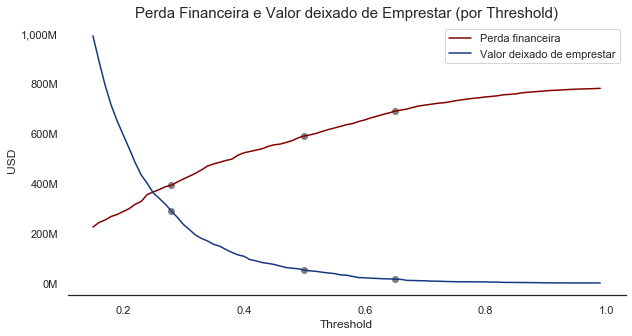

In [134]:
plt.figure(figsize=(10, 5))
df_RF_selected_filtered = df_RF_selected[15:]
ax = sns.lineplot(x='threshold', y='sba_gross_loss', data=df_RF_selected_filtered, color='#830000')
ax = sns.lineplot(x='threshold', y='opportunity_loss', data=df_RF_selected_filtered, color='#163780')
ax.axes.set_title("Perda Financeira e Valor deixado de Emprestar (por Threshold)",fontsize=15)
ax.legend(['Perda financeira', 'Valor deixado de emprestar'])
ylabels = ['{:,.0f}'.format(y) + 'M' for y in ax.get_yticks()/1000000]
ax.set_yticklabels(ylabels)
ax.set(xlabel="Threshold", ylabel="Opportunity Loss")
ax.set_ylabel(ylabel="USD",fontsize=12)
plt.scatter(0.65, df_RF_selected.iloc[65].sba_gross_loss, color='gray')
plt.scatter(0.65, df_RF_selected.iloc[65].opportunity_loss, color='gray')
plt.scatter(0.5, df_RF_selected.iloc[50].sba_gross_loss, color='gray')
plt.scatter(0.5, df_RF_selected.iloc[50].opportunity_loss, color='gray')
plt.scatter(0.28, df_RF_selected.iloc[28].sba_gross_loss, color='gray')
plt.scatter(0.28, df_RF_selected.iloc[28].opportunity_loss, color='gray')
sns.set_style("white")
sns.despine(left=True)

## Entrega 3: Técnicas de Inteligência Artificial

### 6.1.5 Gradient Boosting

### Todas Variáveis

In [107]:
from sklearn.ensemble import GradientBoostingClassifier

GB = GradientBoostingClassifier(random_state=42)

Dicionário de hyperparâmetros para o **GridSearch** do Gradient Boosting

In [108]:
parametros_gb = {'min_samples_split': [3], #[3, 5],
                 'min_samples_leaf': [3], #[3, 5],
                 'max_depth': [5], #[3,5],
                 'n_estimators':[1000],
                 'loss':['deviance'],
                 'learning_rate': [0.05], # 0.2],
                 #'max_features':["log2","sqrt"],
                 #'criterion': ["friedman_mse",  "mae"],
                 #'subsample':[0.5,0.8, 1.0]
                }

# CENARIO 1 (2h16)
# {'learning_rate': 0.05,
#  'loss': 'deviance',
#  'max_depth': 5,
#  'min_samples_leaf': 3,
#  'min_samples_split': 3,
#  'n_estimators': 1000}
# Accuracy  0.9653
# Precision  0.8286
# Recall  0.6856


# Rerun (42min)
# ***********************
# Metrics Report:
# ***********************
# Classification Report:
# ***********************
#   True Positive    2179
#   True Negative   38116
#  False Negative    1002
#  False Positive     465
#        Accuracy  0.9649
#       Precision  0.8241
#          Recall  0.6850
#     Specificity  0.9879
#        F1 Score  0.7482
#   Roc Auc Score  0.9793
# ***********************

In [109]:
%%time
from sklearn.model_selection import GridSearchCV

# assinatura do objeto
grid_GB = GridSearchCV(estimator=GB,
                       param_grid=parametros_gb,
                       cv=5,
                       n_jobs=-1) # tenta rodar em paralelo, se possível
grid_GB.fit(x_treino, y_treino)

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/ensemble/gradient_boosting.py:1450: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 20min 45s, sys: 26.8 s, total: 21min 12s
Wall time: 1h 28min 4s


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no...
                                                  presort='auto',
  

In [110]:
grid_GB.best_score_

0.963643235573002

In [111]:
grid_GB.best_params_

{'learning_rate': 0.05,
 'loss': 'deviance',
 'max_depth': 5,
 'min_samples_leaf': 3,
 'min_samples_split': 3,
 'n_estimators': 1000}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    3918
  True Negative   58450
 False Negative    1464
 False Positive     802
       Accuracy  0.9649
      Precision  0.8301
         Recall  0.7280
    Specificity  0.9865
       F1 Score  0.7757
  Roc Auc Score  0.9806
***********************
Confusion matrix, without normalization:


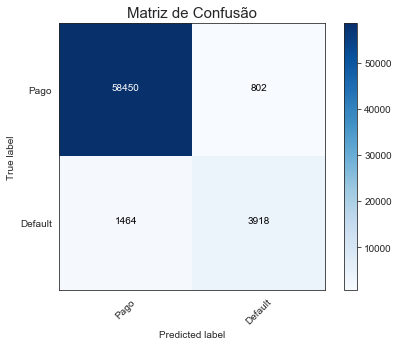

***********************
Curva Roc:
***********************
0.981


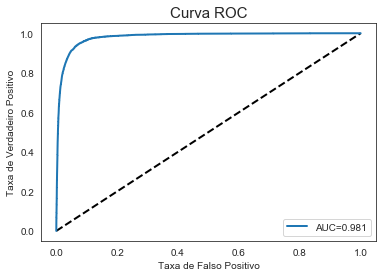

***********************
Curva Precision Recall:
***********************


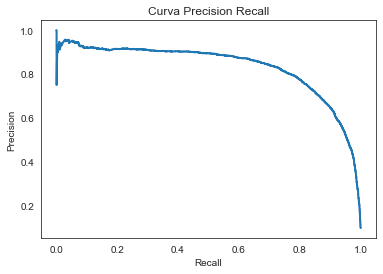

In [112]:
classes = ['Pago','Default']
y_pred = grid_GB.predict(x_teste)
y_scores_GB = grid_GB.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred, y_scores_GB, classes)

In [113]:
from sklearn.externals import joblib

# salva modelo GB sem Seleção de Variáveis
joblib.dump(grid_GB, 'Salvos/200830_grid_GB.pkl', compress = 1)

['Salvos/200830_grid_GB.pkl']

### Gradient Boosting: Com ao menos uma variável selecionada pelos métodos de seleção

In [114]:
from sklearn.ensemble import GradientBoostingClassifier

GB = GradientBoostingClassifier(random_state=42)
parametros_gb = {'min_samples_split': [5],#[3, 5],
                 'min_samples_leaf': [5],
                 'max_depth': [3],#[3,5],
                 'n_estimators':[1000],
                 'loss':['deviance'],
                 'learning_rate': [0.05],#[0.05, 0.2],
                }

In [115]:
%%time
from sklearn.model_selection import GridSearchCV

# assinatura do objeto
grid_GB_selected = GridSearchCV(estimator=GB,
                       param_grid=parametros_gb,
                       cv=5,
                       n_jobs=-1) # tenta rodar em paralelo, se possível
grid_GB_selected.fit(x_treino_selected, y_treino_selected)


# 1h57min
# {'learning_rate': 0.05,
#  'loss': 'deviance',
#  'max_depth': 5,
#  'min_samples_leaf': 5,
#  'min_samples_split': 3,
#  'n_estimators': 1000}

# ***********************
# Classification Report:
# ***********************
#   True Positive    2202
#   True Negative   38105
#  False Negative     979
#  False Positive     476
#        Accuracy  0.9652
#       Precision  0.8223
#          Recall  0.6922
#     Specificity  0.9877
#        F1 Score  0.7517
#   Roc Auc Score  0.9795
# ***********************

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/ensemble/gradient_boosting.py:1450: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 5min 46s, sys: 7.61 s, total: 5min 54s
Wall time: 24min 8s


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no...
                                                  presort='auto',
  

In [116]:
grid_GB_selected.best_score_

0.9600360716393367

In [117]:
grid_GB_selected.best_params_

{'learning_rate': 0.05,
 'loss': 'deviance',
 'max_depth': 3,
 'min_samples_leaf': 5,
 'min_samples_split': 5,
 'n_estimators': 1000}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    3676
  True Negative   58410
 False Negative    1706
 False Positive     842
       Accuracy  0.9606
      Precision  0.8136
         Recall  0.6830
    Specificity  0.9858
       F1 Score  0.7426
  Roc Auc Score  0.9770
***********************
Confusion matrix, without normalization:


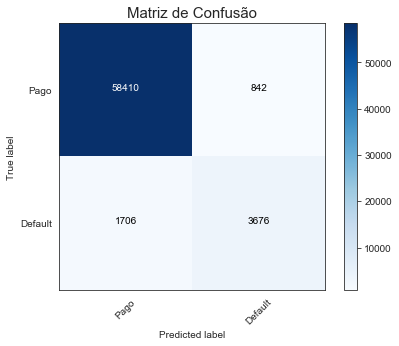

***********************
Curva Roc:
***********************
0.977


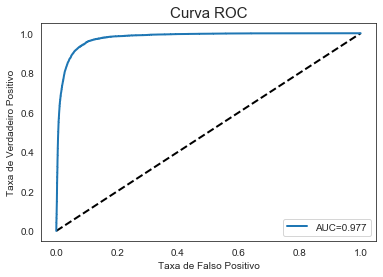

***********************
Curva Precision Recall:
***********************


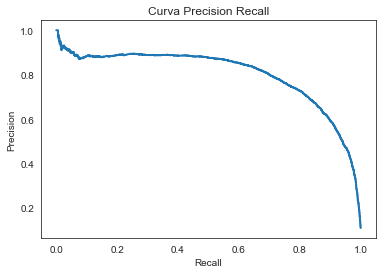

In [118]:
classes = ['Pago','Default']
y_pred_selected = grid_GB_selected.predict(x_teste_selected)
y_scores_GB_selected = grid_GB_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_selected, y_scores_GB_selected, classes)

In [119]:
from sklearn.externals import joblib

# salva modelo GB sem Seleção de Variáveis
joblib.dump(grid_GB_selected, 'Salvos/200830_grid_GB_selected.pkl', compress = 1)

['Salvos/200830_grid_GB_selected.pkl']

### 6.1.6 XGBoosting

### Todas Variáveis

In [ ]:
# %%time
# from sklearn.metrics import roc_auc_score, log_loss
# # An experiment to understand why weak learners work better:
# max_depth = np.unique(np.random.randint(3, 15, size=7))
# num_estimators = np.unique(np.concatenate((np.random.randint(3, 15, size=7), np.random.randint(15, 100, size=5)),axis=0))

# auc = pd.DataFrame()

# for depth in max_depth:
#     for tot_trees in num_estimators:
        
#         xgb_ = XGBClassifier(max_depth=depth, num_estimators=tot_trees)
#         xgb_.fit(x_treino, y_treino)
        
#         test_xgb  = xgb_.predict_proba(x_teste)[:,1]
#         auc_test  = roc_auc_score(y_teste.values, test_xgb)
        

#         auc = pd.concat([auc, pd.DataFrame(data={'AUC': [auc_test], 'max_depth':[depth] , 'num_estimators':[tot_trees]})], axis=0)
#         print(auc)

In [120]:
from xgboost import XGBClassifier

XGB = XGBClassifier(random_state=42)

#brute force scan for all parameters, here are the tricks
#usually max_depth is 6,7,8
#learning rate is around 0.05, but small changes may make big diff
#tuning min_child_weight subsample colsample_bytree can have 
#much fun of fighting against overfit 
#n_estimators is how many round of boosting
#finally, ensemble xgboost with multiple seeds may reduce variance
parameters_xgb = {#'nthread':[4], #when use hyperthread, xgboost may become slower
                  'objective':['binary:logistic'],
                  'learning_rate': [0.1],#[0.05,0.1], #so called `eta` value
                  'max_depth': [2],
                  'min_child_weight': [11],
                  #'silent': [1],
                  #'subsample': [0.8],
                  #'colsample_bytree': [0.7],
                  'n_estimators': [1000], #number of trees, change it to 1000 for better results
                  'scale_pos_weight':[3]
                  #'missing':[-999],
                  #'seed': [1337],
                  #'lambda':[1.2, 1.3],
                  #'alpha':[1.2, 1.3],

                 }

In [121]:
%%time
from sklearn.model_selection import GridSearchCV

# assinatura do objeto
grid_XGB = GridSearchCV(estimator=XGB,
                       param_grid=parameters_xgb,
                       cv=5,
                       n_jobs=-1) # tenta rodar em paralelo, se possível
grid_XGB.fit(x_treino, y_treino)

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:219: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:252: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 15min 26s, sys: 22.6 s, total: 15min 48s
Wall time: 1h 13min 37s


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.1, max_delta_step=0,
                                     max_depth=3, min_child_weight=1,
                                     missing=None, n_estimators=100, n_jobs=1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=42, reg_alpha=0, reg_lambda=1,
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='warn', n_jobs=-1,
             param_grid={'learning_rate': [0.1], 'max_depth': [2],
                         'min_child_weight': [11], 'n_estimators': [1000],
                         '

In [122]:
grid_XGB.best_params_

{'learning_rate': 0.1,
 'max_depth': 2,
 'min_child_weight': 11,
 'n_estimators': 1000,
 'objective': 'binary:logistic',
 'scale_pos_weight': 3}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    4575
  True Negative   56924
 False Negative     807
 False Positive    2328
       Accuracy  0.9515
      Precision  0.6628
         Recall  0.8501
    Specificity  0.9607
       F1 Score  0.7448
  Roc Auc Score  0.9766
***********************
Confusion matrix, without normalization:


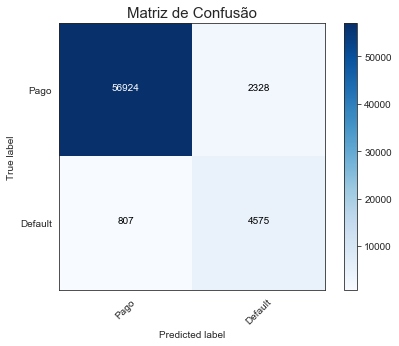

***********************
Curva Roc:
***********************
0.977


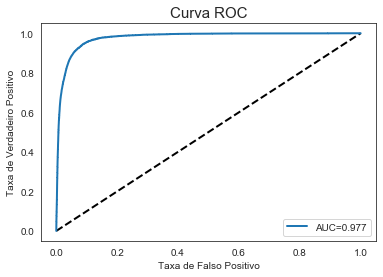

***********************
Curva Precision Recall:
***********************


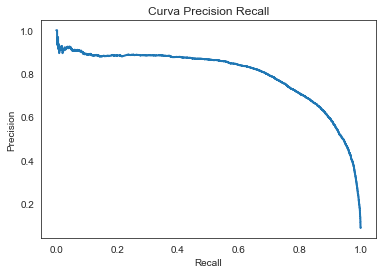

In [123]:
classes = ['Pago','Default']
y_pred = grid_XGB.predict(x_teste)
y_scores_XGB = grid_XGB.predict_proba(x_teste)[:,1]

HelperClass.show_full_classification_report(y_teste, y_pred, y_scores_XGB, classes)

In [124]:
from sklearn.externals import joblib

# salva modelo GB sem Seleção de Variáveis
joblib.dump(grid_XGB, 'Salvos/200830_grid_XGB.pkl', compress = 1)

['Salvos/200830_grid_XGB.pkl']

### XGBoosting: Com ao menos uma variável selecionada pelos métodos de seleção

In [125]:
from xgboost import XGBClassifier

XGB = XGBClassifier(random_state=42)

parameters_xgb = {#'nthread':[4], #when use hyperthread, xgboost may become slower
                  'objective':['binary:logistic'],
                  'learning_rate': [0.1], #so called `eta` value
                  'max_depth': [2],
                  'min_child_weight': [11],
                  #'silent': [1],
                  #'subsample': [0.8],
                  #'colsample_bytree': [0.7],
                  'n_estimators': [1000], #number of trees, change it to 1000 for better results
                  'scale_pos_weight':[3]
                  #'missing':[-999],
                  #'seed': [1337],
                  #'lambda':[1.2, 1.3],
                  #'alpha':[1.2, 1.3],
                 }

In [126]:
%%time
from sklearn.model_selection import GridSearchCV

# assinatura do objeto
grid_XGB_selected = GridSearchCV(estimator=XGB,
                       param_grid=parameters_xgb,
                       cv=5,
                       n_jobs=-1) # tenta rodar em paralelo, se possível
grid_XGB_selected.fit(x_treino_selected, y_treino_selected)

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:219: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/Users/jaime.mishima/miniconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:252: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 7min 56s, sys: 5.12 s, total: 8min 1s
Wall time: 31min 2s


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.1, max_delta_step=0,
                                     max_depth=3, min_child_weight=1,
                                     missing=None, n_estimators=100, n_jobs=1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=42, reg_alpha=0, reg_lambda=1,
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='warn', n_jobs=-1,
             param_grid={'learning_rate': [0.1], 'max_depth': [2],
                         'min_child_weight': [11], 'n_estimators': [1000],
                         '

In [127]:
grid_XGB.best_params_

{'learning_rate': 0.1,
 'max_depth': 2,
 'min_child_weight': 11,
 'n_estimators': 1000,
 'objective': 'binary:logistic',
 'scale_pos_weight': 3}

***********************
Metrics Report:
***********************
Classification Report:
***********************
  True Positive    4574
  True Negative   56872
 False Negative     808
 False Positive    2380
       Accuracy  0.9507
      Precision  0.6578
         Recall  0.8499
    Specificity  0.9598
       F1 Score  0.7416
  Roc Auc Score  0.9766
***********************
Confusion matrix, without normalization:


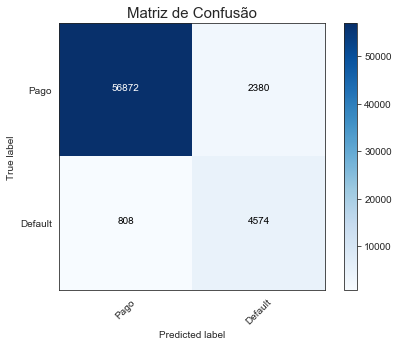

***********************
Curva Roc:
***********************
0.977


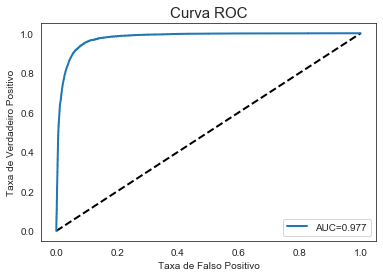

***********************
Curva Precision Recall:
***********************


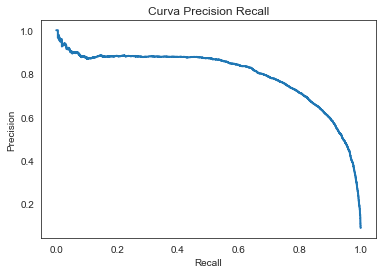

In [128]:
classes = ['Pago','Default']
y_pred_selected = grid_XGB_selected.predict(x_teste_selected)
y_scores_XGB_selected = grid_XGB_selected.predict_proba(x_teste_selected)[:,1]

HelperClass.show_full_classification_report(y_teste_selected, y_pred_selected, y_scores_XGB_selected, classes)

In [129]:
from sklearn.externals import joblib

# salva modelo GB sem Seleção de Variáveis
joblib.dump(grid_XGB_selected, 'Salvos/200830_grid_XGB_selected.pkl', compress = 1)

['Salvos/200830_grid_XGB_selected.pkl']

## Recuperando Modelos Salvos

In [458]:
# Recupera bases salvas
# Salvei o dataframe com as variaveis selecionadas (explicativas_selected) 
# e também quais as variaveis foram selecionadas (var_select_selected)
explicativas_selected =  pd.read_parquet(path+'/200815_explicativas_selected.parquet.gzip')
explicativas =  pd.read_parquet(path+'/200815_explicativas.parquet.gzip')
aux =  pd.read_parquet(path+'/200815_var_select_selected.parquet.gzip')
var_select_selected = aux['var_select_selected'].tolist()
target = pd.read_csv(path+"/200822_target.csv")
target = target.set_index('Unnamed: 0')

explicativas_selected = explicativas[var_select_selected]

x_treino, x_teste, y_treino, y_teste = train_test_split(explicativas,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

x_treino_selected, x_teste_selected, y_treino_selected, y_teste_selected = train_test_split(explicativas_selected,
                                                        target,
                                                        test_size=0.3,
                                                        random_state=42)

In [493]:
# Regressão Logística com todas as variaveis
modelo_treinado_RL = open('Salvos/200815_grid_RL.pkl', 'rb')
model_RL = joblib.load(modelo_treinado_RL)
classes = ['Pago','Default']
y_pred_lido = model_RL.predict(x_teste)
y_scores_RL_lido = model_GB.predict_proba(x_teste)[:,1]
df_RL = HelperClass.classification_dataframe(y_teste, y_pred_lido, y_scores_RL_lido, classes, colName = 'RL')

# Regressão Logística com todas as variaveis
modelo_treinado_RL_selected = open('Salvos/200815_grid_RL_selected.pkl', 'rb')
model_RL_selected = joblib.load(modelo_treinado_RL_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_RL_selected.predict(x_teste_selected)
y_scores_RL_lido_selected = model_RL_selected.predict_proba(x_teste_selected)[:,1]
df_RL_selected = HelperClass.classification_dataframe(y_teste_selected, y_pred_lido_selected, 
                                                      y_scores_RL_lido_selected, classes, colName = 'RL (feature selection)')

# Random Forest com todas as variaveis
modelo_treinado_RF = open('Salvos/200815_grid_RF.pkl', 'rb')
model_RF = joblib.load(modelo_treinado_RF)
classes = ['Pago','Default']
y_pred_lido = model_RF.predict(x_teste)
y_scores_RF_lido = model_GB.predict_proba(x_teste)[:,1]
df_RF = HelperClass.classification_dataframe(y_teste, y_pred_lido, y_scores_RF_lido, classes, colName = 'RF')

# Random Forest com todas as variaveis
modelo_treinado_RF_selected = open('Salvos/200815_grid_RF_selected.pkl', 'rb')
model_RF_selected = joblib.load(modelo_treinado_RF_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_RF_selected.predict(x_teste_selected)
y_scores_RF_lido_selected = model_RF_selected.predict_proba(x_teste_selected)[:,1]
df_RF_selected = HelperClass.classification_dataframe(y_teste_selected, y_pred_lido_selected, 
                                                      y_scores_RF_lido_selected, classes, colName = 'RF (feature selection)')

# Gradient Boosting com todas as variaveis
modelo_treinado_GB = open('Salvos/200816_grid_GB.pkl', 'rb')
model_GB = joblib.load(modelo_treinado_GB)
classes = ['Pago','Default']
y_pred_lido = model_GB.predict(x_teste)
y_scores_GB_lido = model_GB.predict_proba(x_teste)[:,1]
df_GB = HelperClass.classification_dataframe(y_teste, y_pred_lido, y_scores_GB_lido, classes, colName = 'GB')

# Gradient Boosting com todas as variaveis
modelo_treinado_GB_selected = open('Salvos/200816_grid_GB_selected.pkl', 'rb')
model_GB_selected = joblib.load(modelo_treinado_GB_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_GB_selected.predict(x_teste_selected)
y_scores_GB_lido_selected = model_GB_selected.predict_proba(x_teste_selected)[:,1]
df_GB_selected = HelperClass.classification_dataframe(y_teste_selected, y_pred_lido_selected, 
                                                      y_scores_GB_lido_selected, classes, colName = 'GB (feature selection)')

# XGB com todas as variaveis
modelo_treinado_XGB = open('Salvos/200816_grid_XGB.pkl', 'rb')
model_XGB = joblib.load(modelo_treinado_XGB)
classes = ['Pago','Default']
y_pred_lido = model_XGB.predict(x_teste)
y_scores_XGB_lido = model_GB.predict_proba(x_teste)[:,1]
df_XGB = HelperClass.classification_dataframe(y_teste, y_pred_lido, y_scores_XGB_lido, classes, colName = 'XGB')

# Gradient Boosting com todas as variaveis
modelo_treinado_XGB_selected = open('Salvos/200817_grid_XGB_selected.pkl', 'rb')
model_XGB_selected = joblib.load(modelo_treinado_XGB_selected)
classes = ['Pago','Default']
y_pred_lido_selected = model_XGB_selected.predict(x_teste_selected)
y_scores_XGB_lido_selected = model_XGB_selected.predict_proba(x_teste_selected)[:,1]
df_XGB_selected = HelperClass.classification_dataframe(y_teste_selected, y_pred_lido_selected, 
                                                       y_scores_XGB_lido_selected, classes, colName = 'XGB (feature selection)')

In [500]:
df_final = df_RL.merge(df_RL_selected,on='Metrics')\
.merge(df_RF,on='Metrics').merge(df_RF_selected,on='Metrics')\
.merge(df_GB,on='Metrics').merge(df_GB_selected,on='Metrics')\
.merge(df_XGB,on='Metrics').merge(df_XGB_selected,on='Metrics')
df_final

,Metrics,RL,RL (feature selection),RF,RF (feature selection),GB,GB (feature selection),XGB,XGB (feature selection)
0,True Positive,184,169,1225,1333,2179,2202,2615,2611
1,True Negative,38468,38478,38418,38392,38116,38105,37188,37171
2,False Negative,2997,3012,1956,1848,1002,979,566,570
3,False Positive,113,103,163,189,465,476,1393,1410
4,Accuracy,0.9255,0.9254,0.9493,0.9512,0.9649,0.9652,0.9531,0.9526
5,Precision,0.6195,0.6213,0.8826,0.8758,0.8241,0.8223,0.6524,0.6493
6,Recall,0.0578,0.0531,0.3851,0.4191,0.6850,0.6922,0.8221,0.8208
7,Specificity,0.9971,0.9973,0.9958,0.9951,0.9879,0.9877,0.9639,0.9635
8,F1 Score,0.1058,0.0979,0.5362,0.5669,0.7482,0.7517,0.7275,0.7251
9,Roc Auc Score,0.9793,0.8205,0.9793,0.9536,0.9793,0.9795,0.9793,0.9753


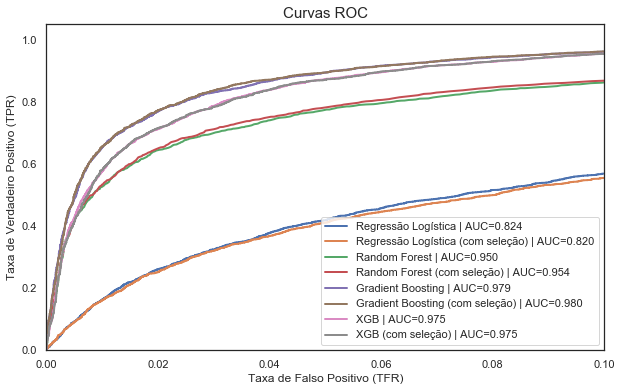

In [505]:
plt.figure(figsize=(10,6))
# RL sem seleção de variáveis
y_scores_RL = model_RL.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RL)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RL))
plt.plot(fpr, tpr, label = 'Regressão Logística | AUC='+str(auc), linewidth = 2)

# RL com seleção de variáveis
y_scores_RL_selected = model_RL_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RL_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RL_selected))
plt.plot(fpr, tpr, label = 'Regressão Logística (com seleção) | AUC='+str(auc), linewidth = 2)

# RF sem seleção de variáveis
y_scores_RF = model_RF.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_RF)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_RF))
plt.plot(fpr, tpr, label = 'Random Forest | AUC='+str(auc), linewidth = 2)

# RF com seleção de variáveis
y_scores_RF_selected = model_RF_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_RF_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_RF_selected))
plt.plot(fpr, tpr, label = 'Random Forest (com seleção) | AUC='+str(auc), linewidth = 2)

# GB sem seleção de variáveis
y_scores_GB = model_GB.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_GB)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_GB))
plt.plot(fpr, tpr, label = 'Gradient Boosting | AUC='+str(auc), linewidth = 2)

# GB com seleção de variáveis
y_scores_GB_selected = model_GB_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_GB_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_GB_selected))
plt.plot(fpr, tpr, label = 'Gradient Boosting (com seleção) | AUC='+str(auc), linewidth = 2)

# XGB sem seleção de variáveis
y_scores_XGB = model_XGB.predict_proba(x_teste)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste, y_scores_XGB)
auc = '{:.3f}'.format(roc_auc_score(y_teste, y_scores_XGB))
plt.plot(fpr, tpr, label = 'XGB | AUC='+str(auc), linewidth = 2)

# XGB com seleção de variáveis
y_scores_XGB_selected = model_XGB_selected.predict_proba(x_teste_selected)[:,1]
fpr, tpr, thresholds = roc_curve(y_teste_selected, y_scores_XGB_selected)
auc = '{:.3f}'.format(roc_auc_score(y_teste_selected, y_scores_XGB_selected))
plt.plot(fpr, tpr, label = 'XGB (com seleção) | AUC='+str(auc), linewidth = 2)

plt.title('Curvas ROC', fontsize=15)
plt.xlim([0.0, 0.1])
# plt.xlim([0.0, 0.2])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falso Positivo (TFR)')
plt.ylabel('Taxa de Verdadeiro Positivo (TPR)')
plt.legend(loc=0)
plt.show()